# Strarting

In [ ]:
import numpy as np
import os
import glob as gb
import cv2
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from numpy.random import shuffle
import matplotlib.pyplot as plt
import pandas as pd
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Concatenate ,Dense,Dropout, Activation,Flatten , Conv2D,MaxPooling2D , MaxPool2D ,Input,AveragePooling2D,BatchNormalization,Average
from keras.utils import np_utils
from tensorflow.keras.models import load_model
from keras.optimizers import RMSprop, Adam
from keras.applications.vgg16 import VGG16
from tensorflow.keras import Model  
from tensorflow.keras.utils import plot_model
from sklearn.metrics import confusion_matrix,ConfusionMatrixDisplay,classification_report,f1_score,accuracy_score,precision_score,recall_score,plot_confusion_matrix
from sklearn.metrics._plot.confusion_matrix import plot_confusion_matrix
import seaborn as sns

In [ ]:
# Connect to google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!gdown https://drive.google.com/file/d/1f6jT_MSh9D5srF1-gLD-AKuCnDs-EzwF/view?usp=share_link

/usr/local/lib/python3.7/dist-packages/gdown/parse_url.py:39: UserWarning: You specified a Google Drive link that is not the correct link to download a file. You might want to try `--fuzzy` option or the following url: https://drive.google.com/uc?id=1f6jT_MSh9D5srF1-gLD-AKuCnDs-EzwF
  url="https://drive.google.com/uc?id={}".format(file_id)
Downloading...
From: https://drive.google.com/file/d/1f6jT_MSh9D5srF1-gLD-AKuCnDs-EzwF/view?usp=share_link
To: /content/view?usp=share_link
71.6kB [00:00, 2.86MB/s]


In [ ]:
 !unzip 'drive/My Drive/DL_Assignment_1_Data.zip' -d '/content/drive/My Drive'

Streaming output truncated to the last 5000 lines.
  inflating: /content/drive/My Drive/Data/train/5/07f1a656b1584238990847.png  
  inflating: /content/drive/My Drive/Data/train/5/a998f70931636275a7d59c.png  
  inflating: /content/drive/My Drive/Data/train/5/4a55bbc7017f0f32bd7406.png  
  inflating: /content/drive/My Drive/Data/train/5/c486fefeacad886fb20c6c.png  
  inflating: /content/drive/My Drive/Data/train/5/ef2f6f97c71f6d11d750ed.png  
  inflating: /content/drive/My Drive/Data/train/5/0819cc67a2edc006b7ddf6.png  
  inflating: /content/drive/My Drive/Data/train/5/b5016eef17579d81e3ea09.png  
  inflating: /content/drive/My Drive/Data/train/5/975198abbfa4ca82b7739d.png  
  inflating: /content/drive/My Drive/Data/train/5/2f4b6889276a32dfb42300.png  
  inflating: /content/drive/My Drive/Data/train/5/ee0afc54a8e053784c6b4b.png  
  inflating: /content/drive/My Drive/Data/train/5/6201bff2a5f0b757913213.png  
  inflating: /content/drive/My Drive/Data/train/5/c45b07932a0e01c6477013.png  
 

In [ ]:
trainpath='/content/drive/MyDrive/Data/train'
testpath='/content/drive/MyDrive/Data/test'

In [ ]:
CLASSES = ['pink primrose',    'hard-leaved pocket orchid', 'canterbury bells', 'sweet pea',     'wild geranium',     'tiger lily',           'moon orchid',              'bird of paradise', 'monkshood',        'globe thistle',         # 00 - 09
           'snapdragon',       "colt's foot",               'king protea',      'spear thistle', 'yellow iris',       'globe-flower',         'purple coneflower',        'peruvian lily',    'balloon flower',   'giant white arum lily', # 10 - 19
           'fire lily',        'pincushion flower',         'fritillary',       'red ginger',    'grape hyacinth',    'corn poppy',           'prince of wales feathers', 'stemless gentian', 'artichoke',        'sweet william',         # 20 - 29
           'carnation',        'garden phlox',              'love in the mist', 'cosmos',        'alpine sea holly',  'ruby-lipped cattleya', 'cape flower',              'great masterwort', 'siam tulip',       'lenten rose',           # 30 - 39
           'barberton daisy',  'daffodil',                  'sword lily',       'poinsettia',    'bolero deep blue',  'wallflower',           'marigold',                 'buttercup',        'daisy',            'common dandelion',      # 40 - 49
           'petunia',          'wild pansy',                'primula',          'sunflower',     'lilac hibiscus',    'bishop of llandaff',   'gaura',                    'geranium',         'orange dahlia',    'pink-yellow dahlia',    # 50 - 59
           'cautleya spicata', 'japanese anemone',          'black-eyed susan', 'silverbush',    'californian poppy', 'osteospermum',         'spring crocus',            'iris',             'windflower',       'tree poppy',            # 60 - 69
           'gazania',          'azalea',                    'water lily',       'rose',          'thorn apple',       'morning glory',        'passion flower',           'lotus',            'toad lily',        'anthurium',             # 70 - 79
           'frangipani',       'clematis',                  'hibiscus',         'columbine',     'desert-rose',       'tree mallow',          'magnolia',                 'cyclamen ',        'watercress',       'canna lily',            # 80 - 89
           'hippeastrum ',     'bee balm',                  'pink quill',       'foxglove',      'bougainvillea',     'camellia',             'mallow',                   'mexican petunia',  'bromelia',         'blanket flower',        # 90 - 99
           'trumpet creeper',  'blackberry lily',           'common tulip',     'wild rose']

print(f'Number of classes is {len(CLASSES)}')     

Number of classes is 104


In [ ]:
# visualize some images from different classes in train folder
plt.figure(figsize=(15,10))
for i in range(36):
  folder_random=np.random.randint(0,104)
  images = gb.glob(pathname= str( trainpath +'/' + str(folder_random) + '/*.png'))
  img_random=np.random.randint(0,int(len(images)))
  plt.subplot(6,6,i+1)
  plt.imshow(cv2.imread(images[img_random]))     
  plt.axis('off')
  plt.title(str(folder_random)+ " " +CLASSES[folder_random])

In [ ]:
# visualize some images from different classes in test folder
plt.figure(figsize=(15,10))
for i in range(36):
  folder_random=np.random.randint(0,104)
  images = gb.glob(pathname= str( testpath +'/' + str(folder_random) + '/*.png'))
  img_random=np.random.randint(0,int(len(images)))
  plt.subplot(6,6,i+1)
  plt.imshow(cv2.imread(images[img_random]))     
  plt.axis('off')
  plt.title(str(folder_random)+ " " +CLASSES[folder_random])

In [ ]:
# how many images found from each train folder
count_img=0
count_folder=0
for folder in  os.listdir(trainpath) : 
    images = gb.glob(pathname= str( trainpath +'/' + folder + '/*.png'))
    count_img+=len(images)
    count_folder+=1
    print(f'For training data , found {len(images)} images in folder {folder}')
print(f'Found {count_img} images belonging to {count_folder} classes.')      

In [ ]:
# how many images found from each test folder
count_img=0
count_folder=0
for folder in  os.listdir(testpath) : 
    images = gb.glob(pathname= str( testpath +'//' + folder + '/*.png'))
    count_img+=len(images)
    count_folder+=1
    print(f'For testing data , found {len(images)} images in folder {folder}')
print(f'Found {count_img} images belonging to {count_folder} classes.')     


In [ ]:
def test(model,testgenerator):
    # Predictions and true labels lists
    labels,pred,images = [],[],[]
    while len(labels) < 3712:
        # get images and labels from batch
        imgs, y = testgenerator.next()
        # Predicting the label of each batch
        pred_output = model.predict(imgs)
        # Adding prediction and labels to list
        pred.extend(pred_output)
        images.extend(imgs)
        labels.extend(y)
    return labels,pred,images

In [ ]:
def split_TF_imgs (y_true,pred,images):
    true_labels=[]
    true_prediction=[]
    true_imgs=[]
    false_labels=[]
    false_prediction=[]
    false_imgs=[]
    for i in range(len(images)):
        if(pred[i]==y_true[i]):
            true_labels.append(y_true[i])
            true_prediction.append(pred[i])
            true_imgs.append(images[i])
        else:
            false_labels.append(y_true[i])
            false_prediction.append(pred[i])
            false_imgs.append(images[i])
    return true_labels,true_prediction,true_imgs,false_labels,false_prediction,false_imgs

# Simple Model

In [ ]:
# DataGenerator for Simple model
s=224
image_size = (s,s)
batch = 32
train_datagen = ImageDataGenerator(rescale = 1/255,
                                   validation_split=0.1,
                                   zoom_range = 0.1,       # Randomly zoom image 
                                   width_shift_range=0.1,  # randomly shift images horizontally (fraction of total width)
                                   height_shift_range=0.1 ,# randomly shift images vertically (fraction of total height)
                                   horizontal_flip=False,  # randomly flip images
                                   vertical_flip=False     # randomly flip images
                                   )
test_datagen = ImageDataGenerator(rescale = 1/255)



train_generator = train_datagen.flow_from_directory(trainpath,
                                                  target_size = image_size , 
                                                  batch_size = batch ,
                                                  subset = 'training',
                                                  shuffle=True,
                                                  class_mode = "categorical",
                                                  seed=42  
                                                  )  

test_generator = test_datagen.flow_from_directory(testpath,
                                                  target_size = image_size , 
                                                  batch_size = batch ,
                                                  class_mode = 'categorical' ,    
                                                  seed=42                                    
                                                  )
validation_generator = train_datagen.flow_from_directory(trainpath,
                                                  target_size = image_size , 
                                                  batch_size = batch ,
                                                  subset = 'validation',
                                                  shuffle=True,
                                                  class_mode = "categorical",
                                                  seed=42
                                                  )

Found 11524 images belonging to 104 classes.
Found 3712 images belonging to 104 classes.
Found 1229 images belonging to 104 classes.


In [ ]:
# Labels in first batch
for batch in train_generator:
  x,y=batch
  print(y)
  break

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


In [ ]:
# visualize some images from different classes in first batch.

for batch in train_generator:
    # batch is a tuple with images and labels
    images,labels=batch
    plt.figure(figsize=(15,10))
    for n , i in enumerate(list(np.arange(0,25))) :
        plt.subplot(5,5,n+1)
        plt.imshow(images[i])
        plt.axis('off')
        class_label=int(np.argmax(labels[i]))
        plt.title(CLASSES[class_label]+ " " +str(class_label))
    break     

In [ ]:
# simple_model = keras.models.Sequential([
#         Conv2D(50,kernel_size=(3,3),activation='relu',input_shape=(s,s,3)),
#         Conv2D(80,kernel_size=(3,3),activation='relu'),
#         MaxPool2D(3,3),
#         Conv2D(120,kernel_size=(3,3),activation='relu'),    
#         Conv2D(150,kernel_size=(3,3),activation='relu'),    
#         Conv2D(200,kernel_size=(3,3),activation='relu'),
#         MaxPool2D(3,3),
#         Flatten() ,    
#         Dense(7000,activation='relu') ,    
#         Dense(4000,activation='relu') ,    
#         Dense(1800,activation='relu') ,
#         Dense(800,activation='relu') ,        
#         Dropout(rate=0.5) ,            
#         Dense(104,activation='softmax') ,    
#         ])
simple_model = keras.models.Sequential([
        Conv2D(90,kernel_size=(3,3),activation='relu',input_shape=(s,s,3)),
        Conv2D(90,kernel_size=(3,3),activation='relu',padding='same'),
        Conv2D(90,kernel_size=(3,3),activation='relu',padding='same'),
        MaxPool2D(pool_size =2, strides =2, padding ='same'),
        BatchNormalization(),

        Conv2D(120,kernel_size=(3,3),activation='relu'),    
        Conv2D(120,kernel_size=(3,3),activation='relu',padding='same'), 
        Conv2D(120,kernel_size=(3,3),activation='relu',padding='same'), 
        MaxPool2D(pool_size =2, strides =2, padding ='same'),   
        BatchNormalization(),

        Conv2D(150,kernel_size=(3,3),activation='relu',padding='same'),
        Conv2D(150,kernel_size=(3,3),activation='relu',padding='same'),
        Conv2D(150,kernel_size=(3,3),activation='relu',padding='same'),
        MaxPool2D(pool_size =2), 
        BatchNormalization(),

        Conv2D(180,kernel_size=(3,3),activation='relu',padding='same'),
        Conv2D(180,kernel_size=(3,3),activation='relu',padding='same'),
        Conv2D(180,kernel_size=(3,3),activation='relu',padding='same'),
        MaxPool2D(pool_size =2), 
        BatchNormalization(),

        Flatten() ,    
        Dense(6000,activation='relu') ,    
        Dense(3500,activation='relu') ,    
        Dense(1800,activation='relu') ,
        Dense(800,activation='relu') ,        
        Dropout(rate=0.5) ,            
        Dense(104,activation='softmax') ,    
        ])

In [ ]:
print('Model Details are : ')
print(simple_model.summary())

In [ ]:
plot_model(simple_model)

In [ ]:
base_learning_rate = 0.00001
simple_model.compile(optimizer=Adam(learning_rate=base_learning_rate),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

In [ ]:
epochs = 5
hist1 = simple_model.fit(train_generator, epochs=epochs,batch_size=32,validation_data = validation_generator)

Epoch 1/5
361/361 [==============================] - 309s 794ms/step - loss: 4.0721 - accuracy: 0.1111 - val_loss: 5.1872 - val_accuracy: 0.0456
Epoch 2/5
361/361 [==============================] - 275s 762ms/step - loss: 3.4854 - accuracy: 0.2009 - val_loss: 3.3024 - val_accuracy: 0.1928
Epoch 3/5
361/361 [==============================] - 285s 788ms/step - loss: 3.2014 - accuracy: 0.2306 - val_loss: 2.8688 - val_accuracy: 0.2945
Epoch 4/5
361/361 [==============================] - 282s 781ms/step - loss: 2.9740 - accuracy: 0.2740 - val_loss: 2.7440 - val_accuracy: 0.3092
Epoch 5/5
361/361 [==============================] - 277s 766ms/step - loss: 2.7667 - accuracy: 0.3063 - val_loss: 2.6475 - val_accuracy: 0.3255


In [ ]:
simple_model.save(os.path.join('/content/drive/MyDrive/saved_models/simple','sm_5e_f.h5'))

In [ ]:
simple_model.save_weights(os.path.join('/content/drive/MyDrive/saved_models','sm_2_w_80e.h5'))

In [ ]:
model = load_model(os.path.join('/content/drive/MyDrive/saved_models','sm_3_50e.h5'))

In [ ]:
simple_model.load_weights(os.path.join('/content/drive/MyDrive/saved_models/simple','sm_3_w_70e.h5'))

In [ ]:
# graph to show overfit from epoch 5 to 25 (Loss)
plt.title('Loss')
plt.plot(hist1.history['loss'], label='loss')
plt.plot(hist1.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.xlabel('loss')
plt.legend(loc='upper right')

In [ ]:
# graph to show overfit from epoch 5 to 25 (Accuracy)
plt.subplot(212)
plt.title('Accuracy')
plt.plot(hist1.history['accuracy'], label='train')
plt.plot(hist1.history['val_accuracy'], label='val')
plt.legend(loc='lower right')
plt.show()

In [ ]:
ModelLoss, ModelAccuracy = simple_model.evaluate(test_generator)
print('Test Loss is {}'.format(ModelLoss))
print('Test Accuracy is {}'.format(ModelAccuracy))

116/116 [==============================] - 30s 153ms/step - loss: 2.5071 - accuracy: 0.5205
Test Loss is 2.507111072540283
Test Accuracy is 0.5204741358757019


In [ ]:
y_t,p,images=test(simple_model,test_generator)
pred=[np.argmax(elements) for elements in p]
y_true=[np.argmax(elements) for elements in y_t]

In [ ]:
# Accuracy: Percentage of correct predictions
# Precision: Correct positive predictions relative to total positive predictions
# Recall: Correct positive predictions relative to total actual positives
fscore=f1_score(y_true, pred, average='macro')
accuracy=accuracy_score(y_true, pred)
precision=(precision_score(y_true, pred, average='macro'))
recall=recall_score(y_true, pred, average='macro')
print(f' Accuracy = {accuracy}\nPrecision = {precision}\n  Recall  = {recall}\n  fscore  = {fscore}')

 Accuracy = 0.5204741379310345
Precision = 0.5355758319007087
  Recall  = 0.45768838682607504
  fscore  = 0.47623662308107284


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
cr=classification_report(y_true, pred ,target_names=CLASSES)
print(cr)

                           precision    recall  f1-score   support

            pink primrose       0.73      0.62      0.67        79
hard-leaved pocket orchid       1.00      0.57      0.73         7
         canterbury bells       0.24      0.28      0.26        40
                sweet pea       0.20      0.11      0.14         9
            wild geranium       0.40      0.29      0.33         7
               tiger lily       0.42      0.47      0.44       114
              moon orchid       0.44      0.64      0.52       216
         bird of paradise       0.43      0.69      0.53        13
                monkshood       0.69      0.67      0.68        27
            globe thistle       0.51      0.69      0.59        77
               snapdragon       0.60      0.62      0.61        66
              colt's foot       0.17      0.17      0.17         6
              king protea       0.83      0.94      0.88        16
            spear thistle       0.33      0.07      0.12     

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
cm=confusion_matrix(y_true=y_true, y_pred=pred)
print(cm)

[[49  0  0 ...  2  0  0]
 [ 0  4  0 ...  0  0  0]
 [ 0  0 11 ...  0  1  0]
 ...
 [ 0  0  0 ...  5  0  0]
 [ 0  0  1 ...  0  5  0]
 [ 0  0  0 ...  0  0  3]]


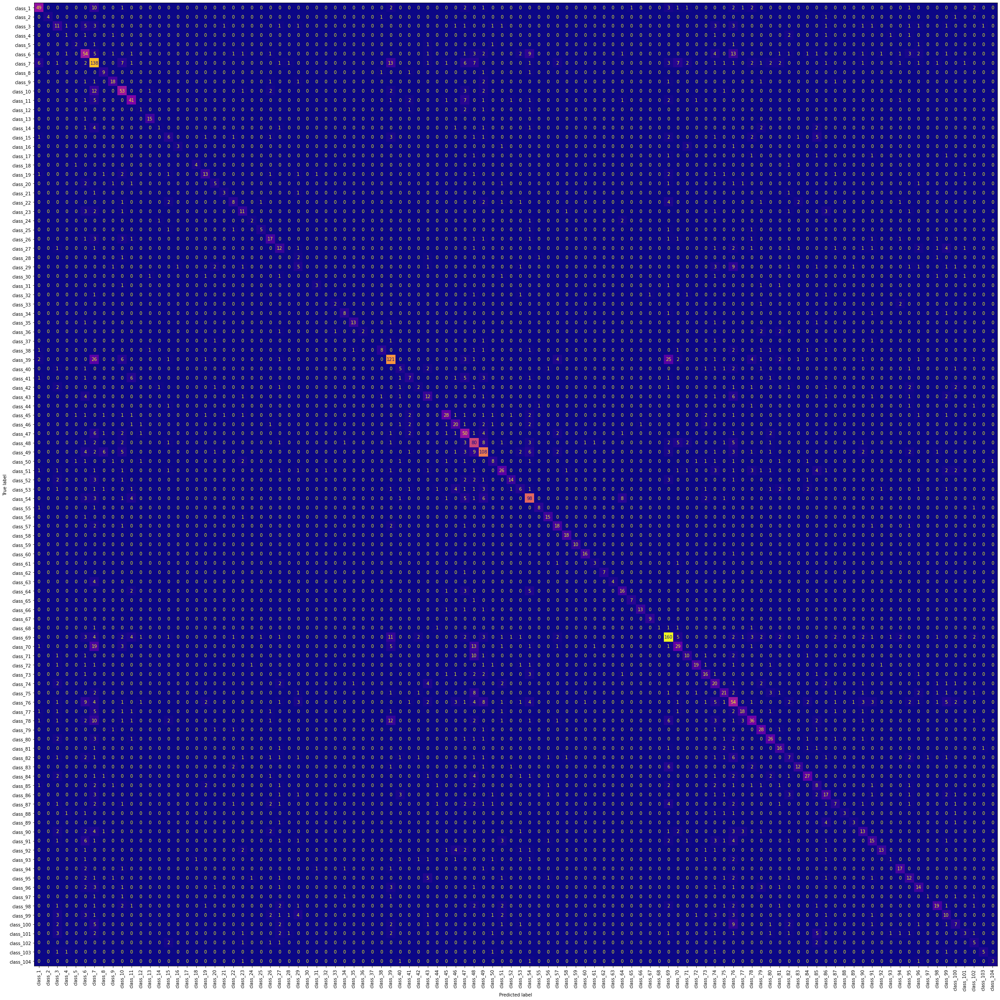

In [ ]:
np.random.seed(0)

labels = [f'class_{i+1}' for i in range(104)]

fig, ax = plt.subplots(figsize=(40, 40))
ConfusionMatrixDisplay.from_predictions(
    y_true, pred, display_labels=labels, xticks_rotation="vertical",
    ax=ax, colorbar=False, cmap="plasma")

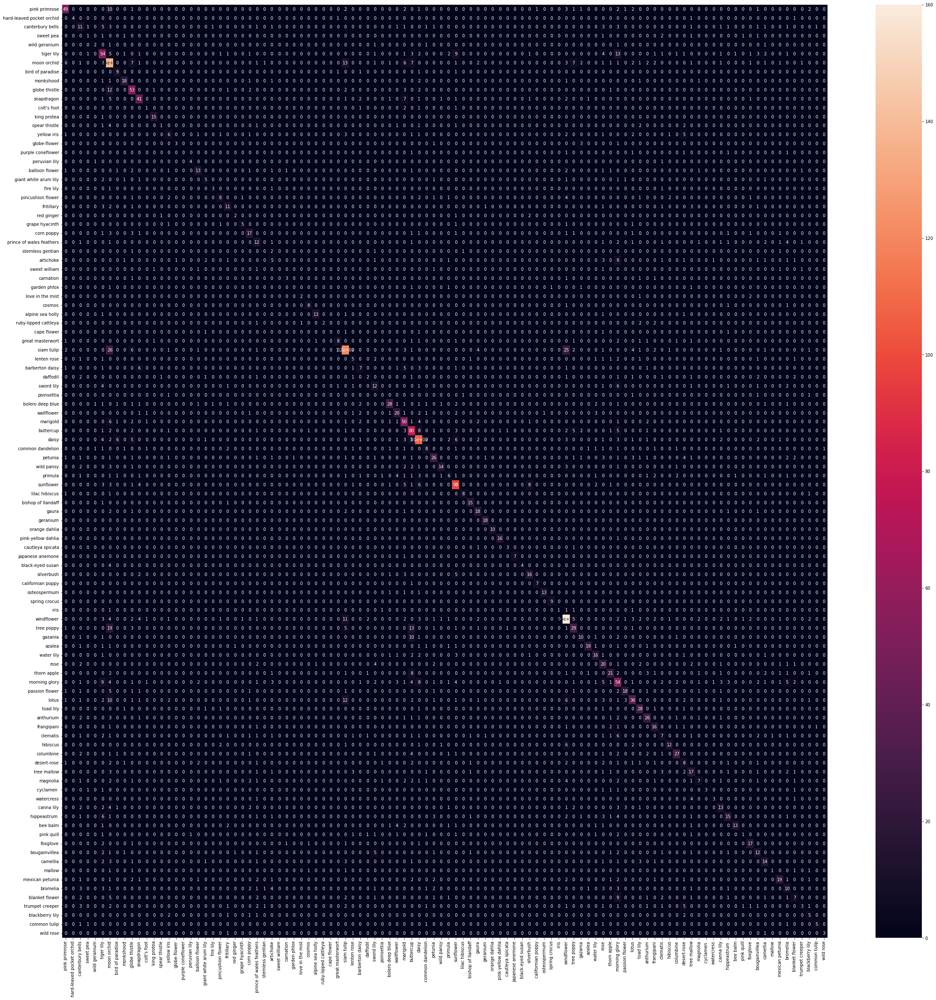

In [ ]:
index = CLASSES 
columns = CLASSES 
cm_df = pd.DataFrame(cm,columns,index)                      
plt.figure(figsize=(40,40))  
sns.heatmap(cm_df, annot=True)

In [ ]:
y_actual = pd.Series(y_true, name='Actual')
y_predicted = pd.Series(pred, name='Predicted')
h=(pd.crosstab(y_actual, y_predicted,rownames=['Actual'], colnames=['Predicted']))
h

Predicted,0,1,2,3,4,5,6,7,8,9,...,94,95,96,97,98,99,100,101,102,103
Actual,,,,,,,,,,,,,,,,,,,,,
0,49,0,0,0,0,0,10,0,0,1,...,1,0,0,0,0,0,0,2,0,0
1,0,4,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
2,0,0,11,1,0,5,3,0,0,0,...,1,1,0,0,1,0,0,0,1,0
3,0,0,0,1,0,1,0,0,1,0,...,1,0,0,0,0,0,0,0,0,0
4,0,0,0,0,2,0,1,0,0,0,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99,0,0,2,0,0,0,5,0,0,0,...,0,1,0,0,1,7,0,0,0,0
100,0,0,3,0,0,0,2,0,0,0,...,1,0,0,0,0,0,3,1,0,0
101,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,5,0,0


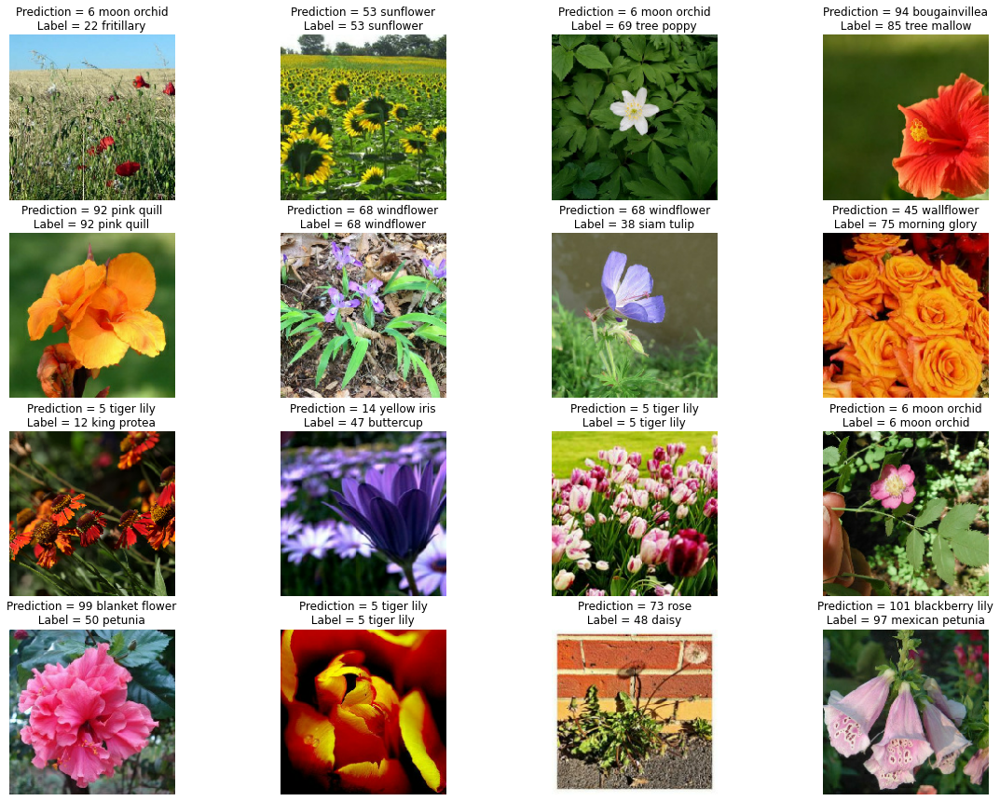

In [ ]:
plt.figure(figsize=(20,15))
for i in range(16):
  plt.subplot(4,4,i+1)
  plt.imshow(images[i])     
  plt.axis('off')
  prediction=pred[i]
  label=int(y_true[i])
  plt.title(f"Prediction = {prediction} {CLASSES[prediction]}\n Label = {label} {CLASSES[label]} ") 

In [ ]:
true_labels,true_prediction,true_imgs,false_labels,false_prediction,false_imgs=split_TF_imgs(y_true,pred,images)

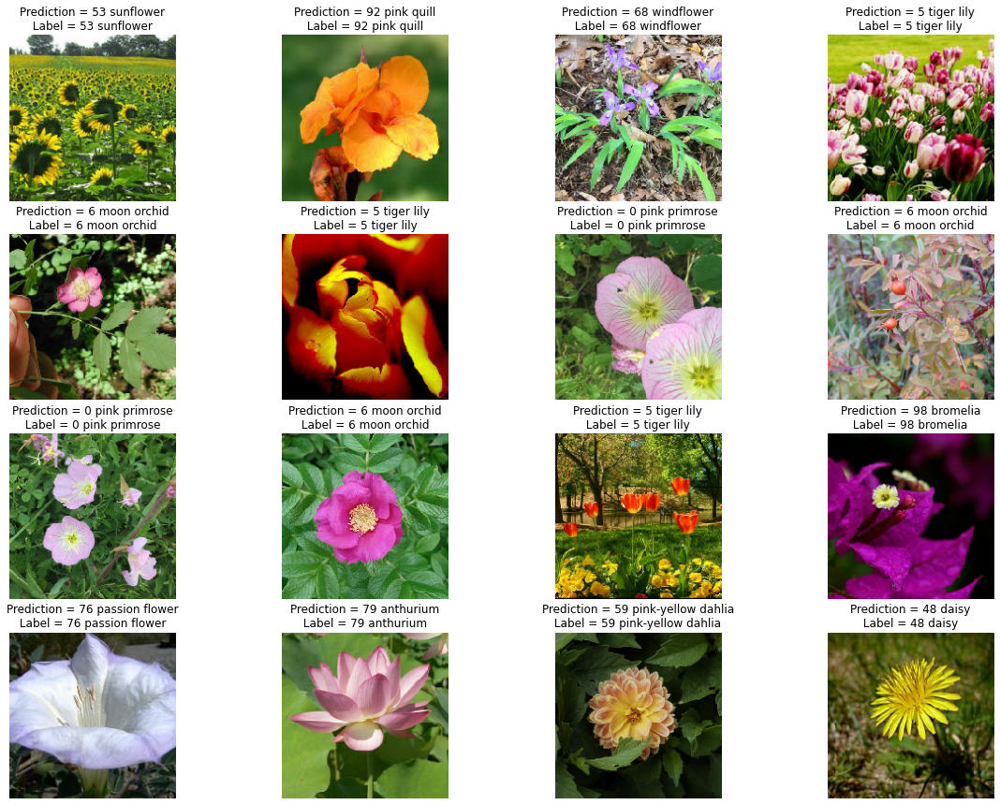

In [ ]:
plt.figure(figsize=(20,15))
for i in range(16):
  plt.subplot(4,4,i+1)
  plt.imshow(true_imgs[i])     
  plt.axis('off')
  prediction=true_prediction[i]
  label=int(true_labels[i])
  plt.title(f"Prediction = {prediction} {CLASSES[prediction]}\n Label = {label} {CLASSES[label]} ")

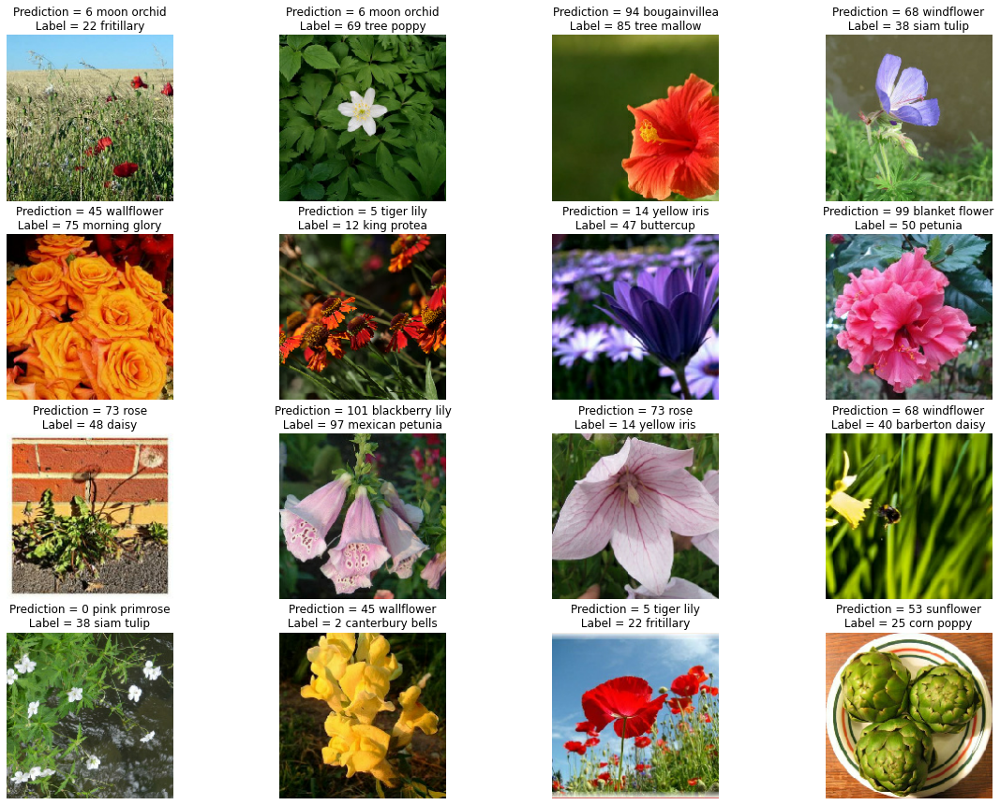

In [ ]:
plt.figure(figsize=(20,15))
for i in range(16):
  plt.subplot(4,4,i+1)
  plt.imshow(false_imgs[i])     
  plt.axis('off')
  prediction=false_prediction[i]
  label=int(false_labels[i])
  plt.title(f"Prediction = {prediction} {CLASSES[prediction]}\n Label = {label} {CLASSES[label]} ")

# VGG Model

In [ ]:
# VGG and Google_Net Models
s=224
image_size = (s,s)
batch = 32
train_datagen2 = ImageDataGenerator(rescale = 1/255,
                                   validation_split=0.1,
                                   zoom_range = 0.1,       # Randomly zoom image 
                                   width_shift_range=0.1,  # randomly shift images horizontally (fraction of total width)
                                   height_shift_range=0.1 ,# randomly shift images vertically (fraction of total height)
                                   horizontal_flip=True,  # randomly flip images
                                   vertical_flip=False     # randomly flip images
                                   )
test_datagen2 = ImageDataGenerator(rescale = 1/255)


train_generator2 = train_datagen2.flow_from_directory(trainpath,
                                                  target_size = image_size , 
                                                  batch_size = batch ,
                                                  subset = 'training',
                                                  shuffle=True,
                                                  class_mode = "sparse",
                                                  seed=42 
                                                  )                                 
test_generator2 = test_datagen2.flow_from_directory(testpath,
                                                  target_size = image_size , 
                                                  batch_size = batch ,
                                                  class_mode = 'sparse' , 
                                                  seed=42                                      
                                                  )
validation_generator2 = train_datagen2.flow_from_directory(trainpath,
                                                  target_size = image_size , 
                                                  batch_size = batch ,
                                                  subset = 'validation',
                                                  shuffle=True,
                                                  class_mode = "sparse",
                                                   seed=42 
                                                  )

Found 11530 images belonging to 104 classes.
Found 3712 images belonging to 104 classes.
Found 1230 images belonging to 104 classes.


In [ ]:
VGG_model = keras.models.Sequential([
        Conv2D(64,kernel_size=(3,3),activation='relu',padding ='same',input_shape=(s,s,3)),
        Conv2D(64,kernel_size=(3,3),activation='relu',padding ='same'),
        MaxPool2D(pool_size =2, strides =2, padding ='same'),

        Conv2D(128,kernel_size=(3,3),activation='relu', padding ='same'),    
        Conv2D(128,kernel_size=(3,3),activation='relu', padding ='same'),    
        MaxPool2D(pool_size =2, strides =2, padding ='same'),

        Conv2D(256,kernel_size=(3,3),activation='relu', padding ='same'),
        Conv2D(256,kernel_size=(3,3),activation='relu', padding ='same'),
        Conv2D(256,kernel_size=(3,3),activation='relu', padding ='same'),
        MaxPool2D(pool_size =2, strides =2, padding ='same'),
        
        Conv2D(512,kernel_size=(3,3),activation='relu', padding ='same'),
        Conv2D(512,kernel_size=(3,3),activation='relu', padding ='same'),
        Conv2D(512,kernel_size=(3,3),activation='relu', padding ='same'),
        MaxPool2D(pool_size =2, strides =2, padding ='same'),

        Conv2D(512,kernel_size=(3,3),activation='relu', padding ='same'),
        Conv2D(512,kernel_size=(3,3),activation='relu', padding ='same'),
        Conv2D(512,kernel_size=(3,3),activation='relu', padding ='same'),
        MaxPool2D(pool_size =2, strides =2, padding ='same'),

        Flatten(),
        Dense(4096, activation ='relu'),
        Dense(4096, activation ='relu'),
        Dense(1000, activation ='softmax'),  
        ])

In [ ]:
print('VGG Model Details are : ')
print(VGG_model.summary())

In [ ]:
plot_model(VGG_model)

In [ ]:
base_learning_rate = 0.0001
VGG_model.compile(optimizer=Adam(learning_rate=base_learning_rate),
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

In [ ]:
epochs = 10
hist2 = VGG_model.fit(train_generator2, epochs=epochs,batch_size=32,validation_data = validation_generator2)

Epoch 1/10
 20/361 [>.............................] - ETA: 5:45 - loss: 0.5324 - accuracy: 0.8359

In [ ]:
VGG_model.save(os.path.join('/content/drive/MyDrive/saved_models','VGG_10e.h5'))

In [ ]:
VGG_model.save_weights(os.path.join('/content/drive/MyDrive/saved_models','VGG_w_10e.h5'))

In [ ]:
model = load_model(os.path.join('/content/drive/MyDrive/saved_models','VGG.h5'))

In [ ]:
VGG_model.load_weights(os.path.join('/content/drive/MyDrive/saved_models','VGG_w_20e.h5'))

In [ ]:
plt.subplot(211)
plt.title('Loss')
plt.plot(VGG_model.history['loss'], label='train')
plt.plot(VGG_model.history['val_loss'], label='test')
plt.legend()

In [ ]:
# plot accuracy during training
plt.subplot(212)
plt.title('Accuracy')
plt.plot(VGG_model.history['accuracy'], label='train')
plt.plot(VGG_model.history['val_accuracy'], label='test')
plt.legend()
plt.show()

In [ ]:
VGG_modelLoss, VGG_modelAccuracy = VGG_model.evaluate(test_generator2)

print(f'Test Loss is {VGG_modelLoss}')
print(f'Test Accuracy is {VGG_modelAccuracy}')

116/116 [==============================] - 22s 167ms/step - loss: 2.1916 - accuracy: 0.5226
Test Loss is 2.191599130630493
Test Accuracy is 0.5226293206214905


In [ ]:
y_true,p,images=test(VGG_model,test_generator2)
pred=[np.argmax(elements) for elements in p]

In [ ]:
# Accuracy: Percentage of correct predictions
# Precision: Correct positive predictions relative to total positive predictions
# Recall: Correct positive predictions relative to total actual positives
fscore=f1_score(y_true, pred, average='macro')
accuracy=accuracy_score(y_true, pred)
precision=(precision_score(y_true, pred, average='macro'))
recall=recall_score(y_true, pred, average='macro')
print(f' Accuracy = {accuracy}\nPrecision = {precision}\n  Recall  = {recall}\n  fscore  = {fscore}')

 Accuracy = 0.5226293103448276
Precision = 0.5177738460748341
  Recall  = 0.4521813725727022
  fscore  = 0.45497559632447565


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
cr=classification_report(y_true, pred ,target_names=CLASSES)
print(cr)

                           precision    recall  f1-score   support

            pink primrose       0.82      0.47      0.60        79
hard-leaved pocket orchid       0.80      0.57      0.67         7
         canterbury bells       0.25      0.10      0.14        40
                sweet pea       0.33      0.11      0.17         9
            wild geranium       0.22      0.29      0.25         7
               tiger lily       0.43      0.36      0.39       114
              moon orchid       0.55      0.56      0.55       216
         bird of paradise       0.60      0.23      0.33        13
                monkshood       0.64      0.59      0.62        27
            globe thistle       0.69      0.75      0.72        77
               snapdragon       0.56      0.80      0.66        66
              colt's foot       0.20      0.17      0.18         6
              king protea       0.82      0.88      0.85        16
            spear thistle       0.08      0.07      0.07     

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
cm=confusion_matrix(y_true=y_true, y_pred=pred)
print(cm)

[[37  0  0 ...  0  0  0]
 [ 0  4  0 ...  0  0  0]
 [ 0  0  4 ...  0  0  0]
 ...
 [ 0  0  0 ...  6  0  0]
 [ 0  0  0 ...  0  6  0]
 [ 0  0  0 ...  0  0  5]]


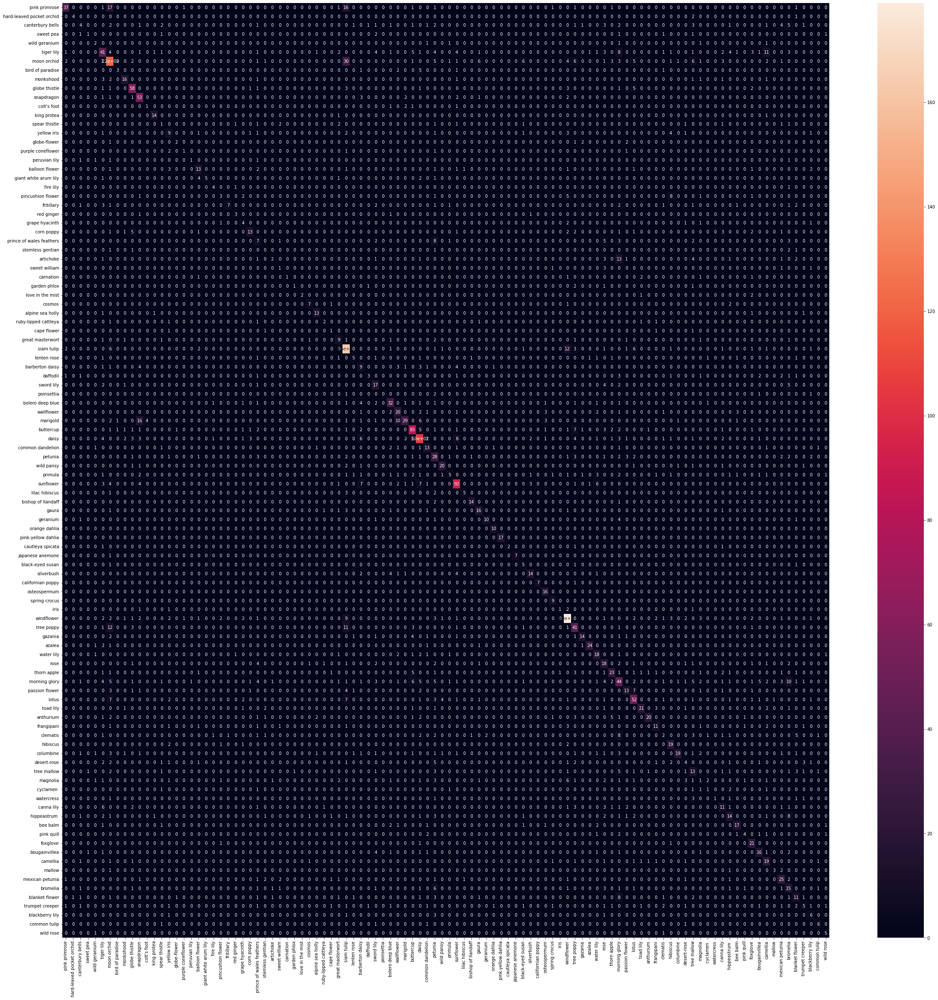

In [ ]:
index = CLASSES 
columns = CLASSES 
cm_df = pd.DataFrame(cm,columns,index)                      
plt.figure(figsize=(40,40))  
sns.heatmap(cm_df, annot=True)

In [ ]:
y_actual = pd.Series(y_true, name='Actual')
y_predicted = pd.Series(pred, name='Predicted')
h=(pd.crosstab(y_actual, y_predicted,rownames=['Actual'], colnames=['Predicted']))
h

Predicted,0,1,2,3,4,5,6,7,8,9,...,94,95,96,97,98,99,100,101,102,103
Actual,,,,,,,,,,,,,,,,,,,,,
0.0,37,0,0,0,0,1,17,0,0,0,...,0,0,0,0,0,1,0,0,0,0
1.0,0,4,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
2.0,0,0,4,0,0,0,2,0,0,0,...,0,1,0,4,5,0,1,0,0,0
3.0,0,0,1,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
4.0,0,0,0,0,2,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99.0,0,1,1,0,0,0,1,0,0,0,...,0,0,0,0,1,11,1,0,0,0
100.0,1,0,1,0,0,0,0,0,0,0,...,1,0,0,1,0,2,5,1,0,1
101.0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,6,0,0


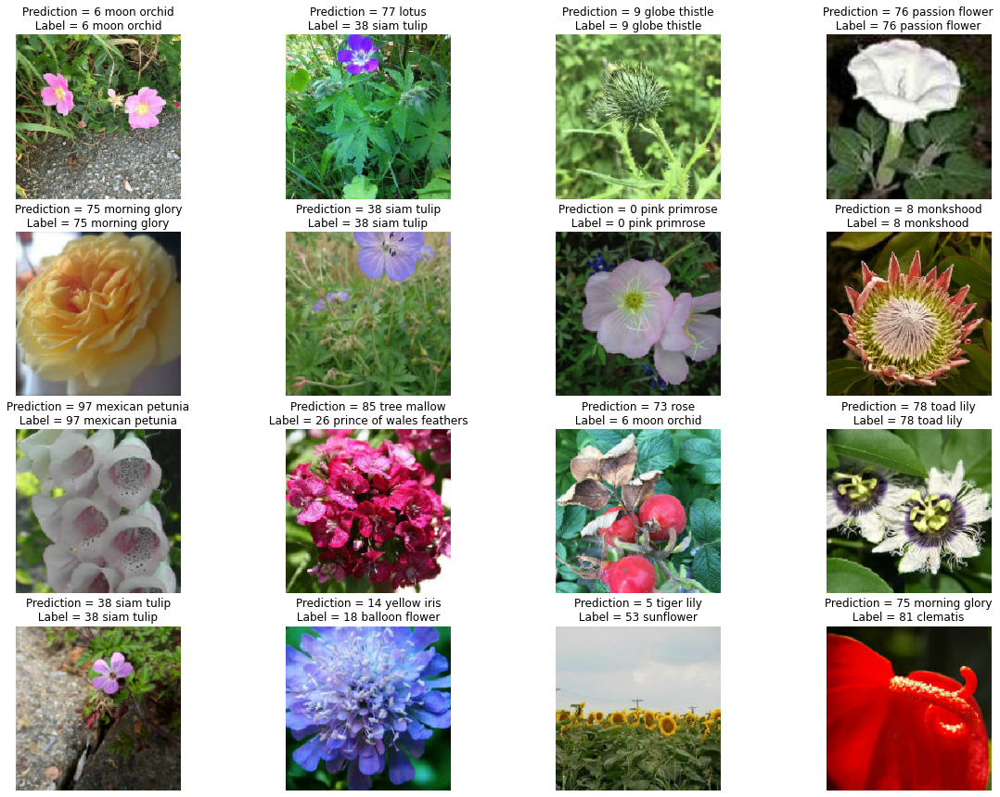

In [ ]:
plt.figure(figsize=(20,15))
for i in range(16):
  plt.subplot(4,4,i+1)
  plt.imshow(images[i])     
  plt.axis('off')
  prediction=pred[i]
  label=int(y_true[i])
  plt.title(f"Prediction = {prediction} {CLASSES[prediction]}\n Label = {label} {CLASSES[label]} ")

In [ ]:
true_labels,true_prediction,true_imgs,false_labels,false_prediction,false_imgs=split_TF_imgs(y_true,pred,images)

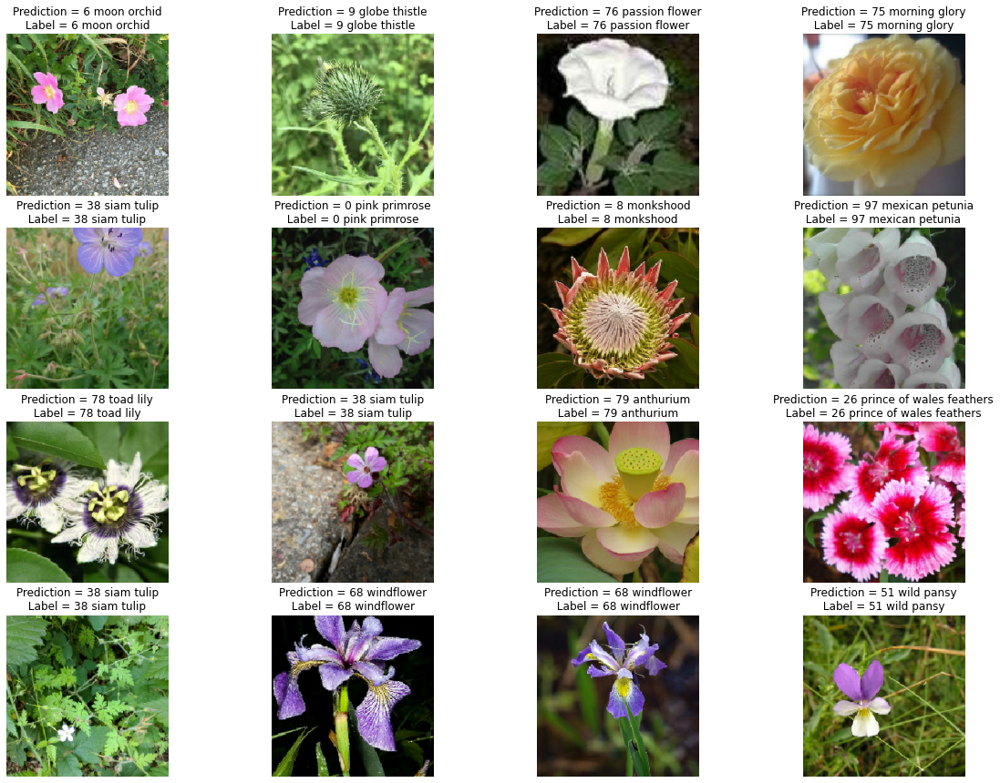

In [ ]:
plt.figure(figsize=(20,15))
for i in range(16):
  plt.subplot(4,4,i+1)
  plt.imshow(true_imgs[i])     
  plt.axis('off')
  prediction=true_prediction[i]
  label=int(true_labels[i])
  plt.title(f"Prediction = {prediction} {CLASSES[prediction]}\n Label = {label} {CLASSES[label]} ")

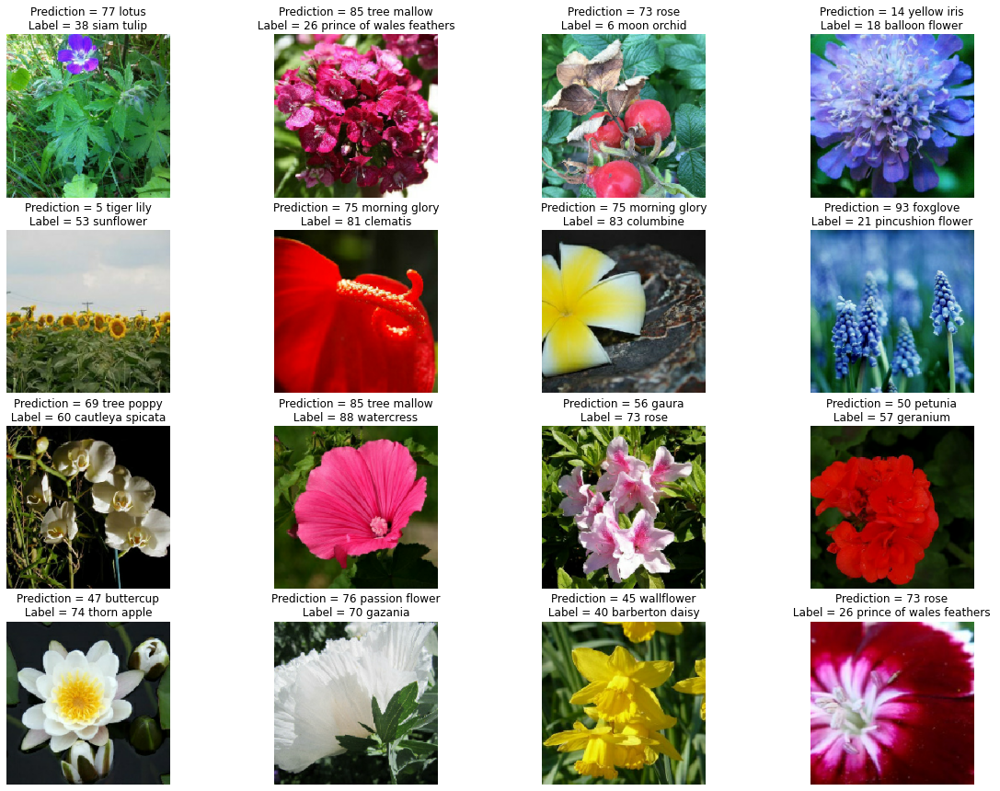

In [ ]:
plt.figure(figsize=(20,15))
for i in range(16):
  plt.subplot(4,4,i+1)
  plt.imshow(false_imgs[i])     
  plt.axis('off')
  prediction=false_prediction[i]
  label=int(false_labels[i])
  plt.title(f"Prediction = {prediction} {CLASSES[prediction]}\n Label = {label} {CLASSES[label]} ")  

# Google_Net Model

In [ ]:
# Function to help us in GoogleNet Sequential
def inception_block(filters) : 
    model = keras.models.Sequential([
    Conv2D(filters[0] , kernel_size=1 , activation="relu"),


    Conv2D(filters[1] , kernel_size=1 , activation="relu"),
    Conv2D(filters[2] , kernel_size=3 , padding="same" ,  activation="relu"),


    Conv2D(filters[3] , kernel_size=1 , activation="relu"),
    Conv2D(filters[4] , kernel_size=5 , padding="same" ,  activation="relu"),


    MaxPool2D(pool_size=3 , strides=1 , padding="same"),
    Conv2D(filters[5] , kernel_size=1 , activation="relu")])

    return model

In [ ]:
GoogleNet_model = keras.models.Sequential([
        Conv2D(64,kernel_size=(7,7),activation='relu' , strides=2 ,padding ='same',input_shape=(224,224,3)),
        MaxPool2D(pool_size=3 , strides=2 , padding='same'),

        Conv2D(64,kernel_size=(1,1),activation='relu'),    
        Conv2D(192,kernel_size=(3,3),activation='relu'),    
        MaxPool2D(pool_size =3, strides =2, padding ='same'),

        inception_block([64,96,128,16,32,32]),
        inception_block([128,128,192,32,96,64]),
        MaxPool2D(pool_size=3 , strides=2 , padding="same"),
        
        inception_block([192,96,208,16,48,64]),
        inception_block([160,112,224,24,64,64]),
        inception_block([128,128,256,24,64,64]),
        inception_block([112,144,288,32,64,64]),
        inception_block([256,160,320,32,128,128]),
        MaxPool2D(pool_size=3 , strides=2 , padding="same"),

        inception_block([256,160,320,32,128,128]),
        inception_block([384,192,384,48,128,128]),
        AveragePooling2D(pool_size=7 , strides=1),


        Dropout(rate=0.4),
        Dense(1000 , activation="softmax"),
        ])

In [ ]:
print('GoogleNet Model Details are : ')
print(GoogleNet_model.summary())

In [ ]:
plot_model(GoogleNet_model)

In [ ]:
base_learning_rate = 0.0001
GoogleNet_model.compile(optimizer=Adam(learning_rate=base_learning_rate),
              loss='sparse_categorical_crossentropy',
              metrics=['acc'])

In [ ]:
epochs = 2
hist3 = GoogleNet_model.fit(train_generator2, epochs=epochs,batch_size=32,validation_data = validation_generator2)

Epoch 1/2
361/361 [==============================] - 189s 511ms/step - loss: 4.1861 - accuracy: 0.0576 - val_loss: 4.1197 - val_accuracy: 0.0629
Epoch 2/2
361/361 [==============================] - 173s 478ms/step - loss: 4.1815 - accuracy: 0.0597 - val_loss: 4.1216 - val_accuracy: 0.0606


In [ ]:
GoogleNet_model.save(os.path.join('/content/drive/MyDrive/Models','1_train90_test40.h5'))

In [ ]:
GoogleNet_model.save_weights(os.path.join('/content/drive/MyDrive/saved_models','VGG_w_10e.h5'))

In [ ]:
GoogleNet_model = load_model(os.path.join('/content/drive/MyDrive/saved_models','Googlenet.h5'))

In [ ]:
GoogleNet_model.load_weights(os.path.join('/content/drive/MyDrive/saved_models','Googlenet.h5'))

In [ ]:
plt.subplot(211)
plt.title('Loss')
plt.plot(google_model.history['loss'], label='train')
plt.plot(google_model.history['val_loss'], label='test')
plt.legend()

In [ ]:
# plot accuracy during training
plt.subplot(212)
plt.title('Accuracy')
plt.plot(google_model.history['accuracy'], label='train')
plt.plot(google_model.history['val_accuracy'], label='test')
plt.legend()
plt.show()

In [ ]:
GoogleNet_model_Loss, GoogleNet_model_Accuracy = GoogleNet_model.evaluate(test_generator2)

print(f'Test Loss is {GoogleNet_model_Loss}')
print(f'Test Accuracy is {GoogleNet_model_Accuracy}')

116/116 [==============================] - 17s 143ms/step - loss: 4.1592 - accuracy: 0.0582
Test Loss is 4.159178256988525
Test Accuracy is 0.05818965658545494


In [ ]:
y_true,p,images=test(GoogleNet_model,test_generator2)
pred=[np.argmax(elements) for elements in p]

68

In [ ]:
# Accuracy: Percentage of correct predictions
# Precision: Correct positive predictions relative to total positive predictions
# Recall: Correct positive predictions relative to total actual positives
fscore=f1_score(y_true, pred, average='macro')
accuracy=accuracy_score(y_true, pred)
precision=(precision_score(y_true, pred, average='macro'))
recall=recall_score(y_true, pred, average='macro')
print(f' Accuracy = {accuracy}\nPrecision = {precision}\n  Recall  = {recall}\n  fscore  = {fscore}')

 Accuracy = 0.061422413793103446
Precision = 0.0005906001326259946
  Recall  = 0.009615384615384616
  fscore  = 0.0011128465443186256


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
cr=classification_report(y_true, pred ,target_names=CLASSES)
print(cr)

In [ ]:
cm=confusion_matrix(y_true=y_true, y_pred=pred)
print(cm)

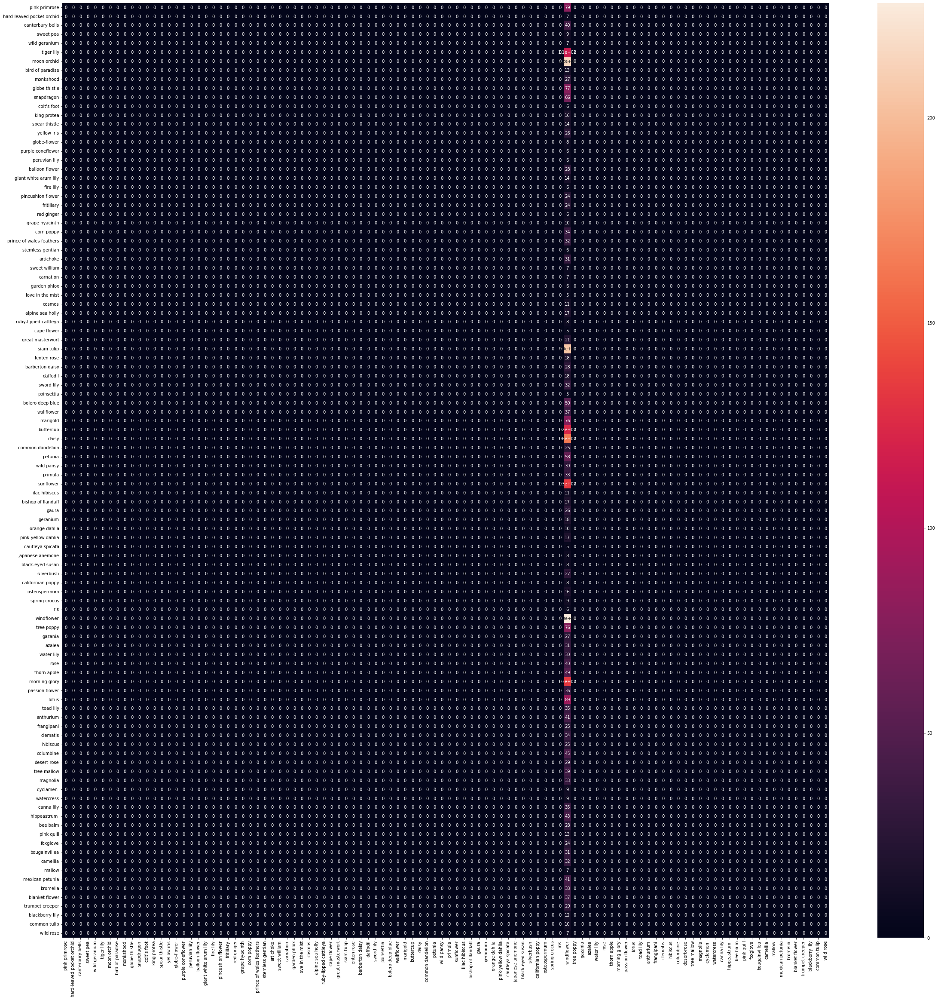

In [ ]:
index = CLASSES 
columns = CLASSES 
cm_df = pd.DataFrame(cm,columns,index)                      
plt.figure(figsize=(40,40))  
sns.heatmap(cm_df, annot=True)

In [ ]:
y_actual = pd.Series(y_true, name='Actual')
y_predicted = pd.Series(pred, name='Predicted')
h=(pd.crosstab(y_actual, y_predicted,rownames=['Actual'], colnames=['Predicted']))
h  

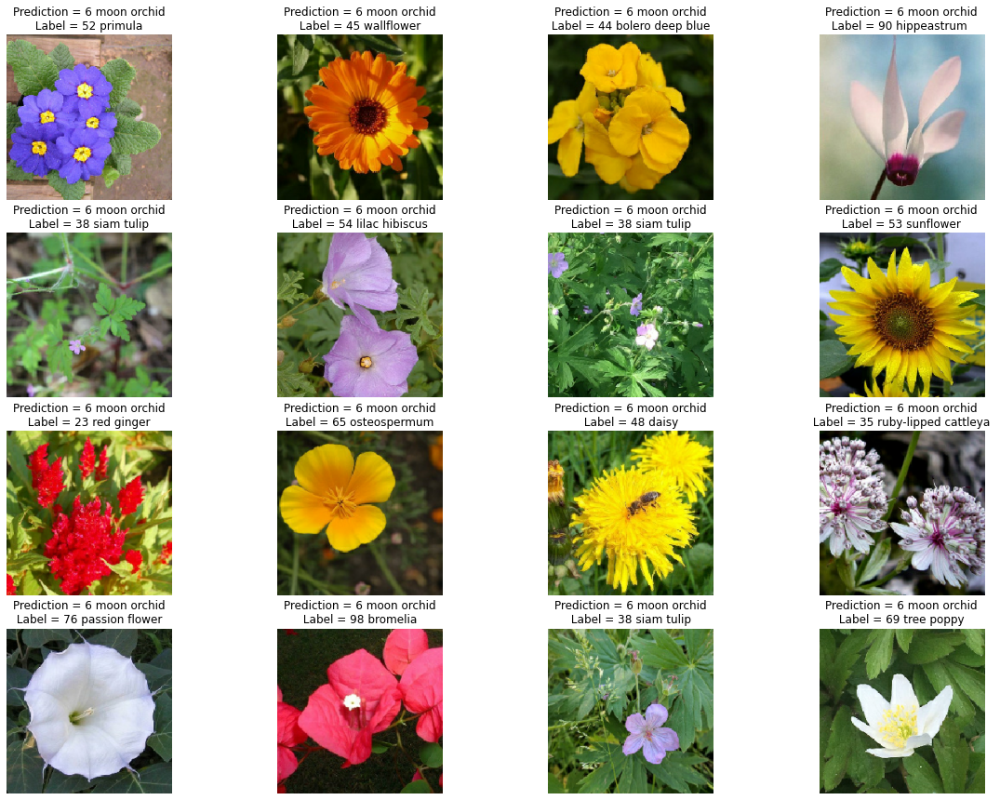

In [ ]:
plt.figure(figsize=(20,15))
for i in range(16):
  plt.subplot(4,4,i+1)
  plt.imshow(images[i])     
  plt.axis('off')
  prediction=pred[i]
  label=int(y_true[i])
  plt.title(f"Prediction = {prediction} {CLASSES[prediction]}\n Label = {label} {CLASSES[label]} ")

In [ ]:
  true_labels,true_prediction,true_imgs,false_labels,false_prediction,false_imgs=split_TF_imgs(y_true,pred,images)

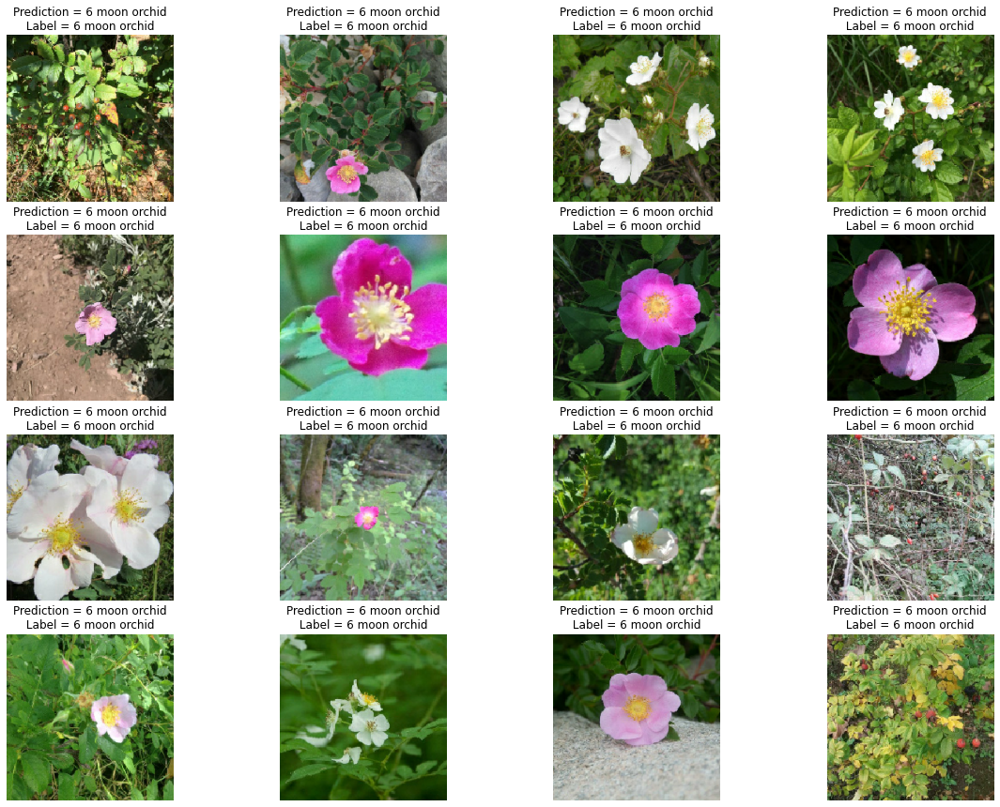

In [ ]:
plt.figure(figsize=(20,15))
for i in range(16):
  plt.subplot(4,4,i+1)
  plt.imshow(true_imgs[i])     
  plt.axis('off')
  prediction=true_prediction[i]
  label=int(true_labels[i])
  plt.title(f"Prediction = {prediction} {CLASSES[prediction]}\n Label = {label} {CLASSES[label]} ")

In [ ]:
  plt.figure(figsize=(20,15))
for i in range(16):
  plt.subplot(4,4,i+1)
  plt.imshow(false_imgs[i])     
  plt.axis('off')
  prediction=false_prediction[i]
  label=int(false_labels[i])
  plt.title(f"Prediction = {prediction} {CLASSES[prediction]}\n Label = {label} {CLASSES[label]} ")

# Transfer Learning

In [ ]:
# Transfer Learning
s=70
image_size = (s,s)
batch = 32
train_datagen3 = ImageDataGenerator(rescale = 1/255,
                                   validation_split=0.1,
                                   zoom_range = 0.1,       # Randomly zoom image 
                                   width_shift_range=0.1,  # randomly shift images horizontally (fraction of total width)
                                   height_shift_range=0.1 ,# randomly shift images vertically (fraction of total height)
                                   horizontal_flip=True,  # randomly flip images
                                   vertical_flip=False     # randomly flip images
                                   )

test_datagen3 = ImageDataGenerator(rescale = 1/255)



train_generator3 = train_datagen3.flow_from_directory(trainpath,
                                                  target_size = image_size , 
                                                  batch_size = batch ,
                                                  subset = 'training',
                                                  shuffle=True,
                                                  class_mode = "sparse",
                                                  seed=42
                                                  )                                 
test_generator3 = test_datagen3.flow_from_directory(testpath,
                                                  target_size = image_size , 
                                                  batch_size = batch ,
                                                  class_mode = 'sparse' ,
                                                  seed=42                                    
                                                  )
validation_generator3 = train_datagen3.flow_from_directory(trainpath,
                                                  target_size = image_size , 
                                                  batch_size = batch ,
                                                  subset = 'validation',
                                                  shuffle=True,
                                                  class_mode = "sparse",
                                                  seed=42
                                                  )

Found 11524 images belonging to 104 classes.
Found 3752 images belonging to 104 classes.
Found 1229 images belonging to 104 classes.


In [ ]:
 # using the pretrained weights of VGG16 model
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(s, s, 3))

In [ ]:
# Freeze all the layers
for layer in base_model.layers[:]:
    layer.trainable = False

In [ ]:
# transfer model
# Create the model
TL_model = Sequential()
 
# Add convolutional base model
TL_model.add(base_model)
 
# Add new dense layers
TL_model.add(Flatten())
TL_model.add(Dense(1024, activation='relu'))
TL_model.add(Dropout(0.5))
TL_model.add(Dense(104, activation='softmax'))

In [ ]:
print('TL Model Details are : ')
print(TL_model.summary())

In [ ]:
plot_model(TL_model)

In [ ]:
base_learning_rate = 0.0001
TL_model.compile(optimizer=Adam(learning_rate=base_learning_rate),
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

In [ ]:
epochs = 20
hist4 = TL_model.fit(train_generator3, epochs=epochs,batch_size=32,validation_data = validation_generator3)

Epoch 1/20
361/361 [==============================] - 63s 173ms/step - loss: 1.7238 - accuracy: 0.5373 - val_loss: 1.8853 - val_accuracy: 0.5110
Epoch 2/20
361/361 [==============================] - 62s 172ms/step - loss: 1.6875 - accuracy: 0.5451 - val_loss: 1.8386 - val_accuracy: 0.5183
Epoch 3/20
361/361 [==============================] - 61s 170ms/step - loss: 1.6602 - accuracy: 0.5545 - val_loss: 1.8441 - val_accuracy: 0.5069
Epoch 4/20
361/361 [==============================] - 62s 171ms/step - loss: 1.6427 - accuracy: 0.5574 - val_loss: 1.8237 - val_accuracy: 0.5216
Epoch 5/20
361/361 [==============================] - 63s 173ms/step - loss: 1.6179 - accuracy: 0.5653 - val_loss: 1.8472 - val_accuracy: 0.5142
Epoch 6/20
361/361 [==============================] - 63s 174ms/step - loss: 1.5852 - accuracy: 0.5686 - val_loss: 1.8015 - val_accuracy: 0.5395
Epoch 7/20
361/361 [==============================] - 62s 171ms/step - loss: 1.5720 - accuracy: 0.5695 - val_loss: 1.8676 - val_ac

In [ ]:
TL_model.save(os.path.join('/content/drive/MyDrive/saved_models','Trans.h5'))

In [ ]:
TL_model.save_weights(os.path.join('/content/drive/MyDrive/saved_models','TL_w_40e.h5'))

In [ ]:
new_model = load_model(os.path.join('saved_models','1_train90_test40.h5'))

In [ ]:
TL_model.load_weights(os.path.join('/content/drive/MyDrive/saved_models','TL_w_20e.h5'))

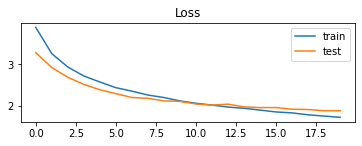

In [ ]:
# plot loss during training
plt.subplot(211)
plt.title('Loss')
plt.plot(hist4.history['loss'], label='train')
plt.plot(hist4.history['val_loss'], label='test')
plt.legend()

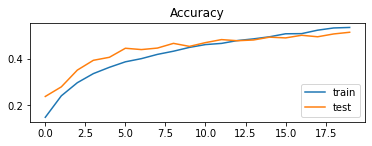

In [ ]:
# plot accuracy during training
plt.subplot(212)
plt.title('Accuracy')
plt.plot(hist4.history['accuracy'], label='train')
plt.plot(hist4.history['val_accuracy'], label='test')
plt.legend()
plt.show()

In [ ]:
TL_model_Loss, TL_model_Accuracy = TL_model.evaluate(test_generator3)

print(f'Test Loss is {TL_model_Loss}')
print(f'Test Accuracy is {TL_model_Accuracy}')

118/118 [==============================] - 13s 112ms/step - loss: 1.6994 - accuracy: 0.5533
Test Loss is 1.6994314193725586
Test Accuracy is 0.55330491065979


In [ ]:
y_true,p,images=test(TL_model,test_generator3)
pred=[np.argmax(elements) for elements in p]

In [ ]:
# Accuracy: Percentage of correct predictions
# Precision: Correct positive predictions relative to total positive predictions
# Recall: Correct positive predictions relative to total actual positives
fscore=f1_score(y_true, pred, average='macro')
accuracy=accuracy_score(y_true, pred)
precision=(precision_score(y_true, pred, average='macro'))
recall=recall_score(y_true, pred, average='macro')
print(f' Accuracy = {accuracy}\nPrecision = {precision}\n  Recall  = {recall}\n  fscore  = {fscore}')

 Accuracy = 0.5543010752688172
Precision = 0.5850212409527471
  Recall  = 0.48445489707705963
  fscore  = 0.509211894463294


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
cr=classification_report(y_true, pred ,target_names=CLASSES)
print(cr)

                           precision    recall  f1-score   support

            pink primrose       0.38      0.57      0.45        79
hard-leaved pocket orchid       1.00      0.43      0.60         7
         canterbury bells       0.12      0.05      0.07        40
                sweet pea       0.00      0.00      0.00         9
            wild geranium       0.00      0.00      0.00         7
               tiger lily       0.40      0.61      0.48       114
              moon orchid       0.30      0.55      0.39       216
         bird of paradise       1.00      0.15      0.27        13
                monkshood       0.71      0.37      0.49        27
            globe thistle       0.61      0.45      0.52        77
               snapdragon       0.49      0.74      0.59        66
              colt's foot       0.00      0.00      0.00         6
              king protea       0.81      0.81      0.81        16
            spear thistle       0.00      0.00      0.00     

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
cm=confusion_matrix(y_true=y_true, y_pred=pred)
print(cm)

[[45  0  0 ...  0  0  0]
 [ 0  3  0 ...  0  0  0]
 [ 0  0  2 ...  0  0  0]
 ...
 [ 0  0  0 ...  0  0  0]
 [ 0  0  0 ...  0  6  0]
 [ 0  0  0 ...  0  0  1]]


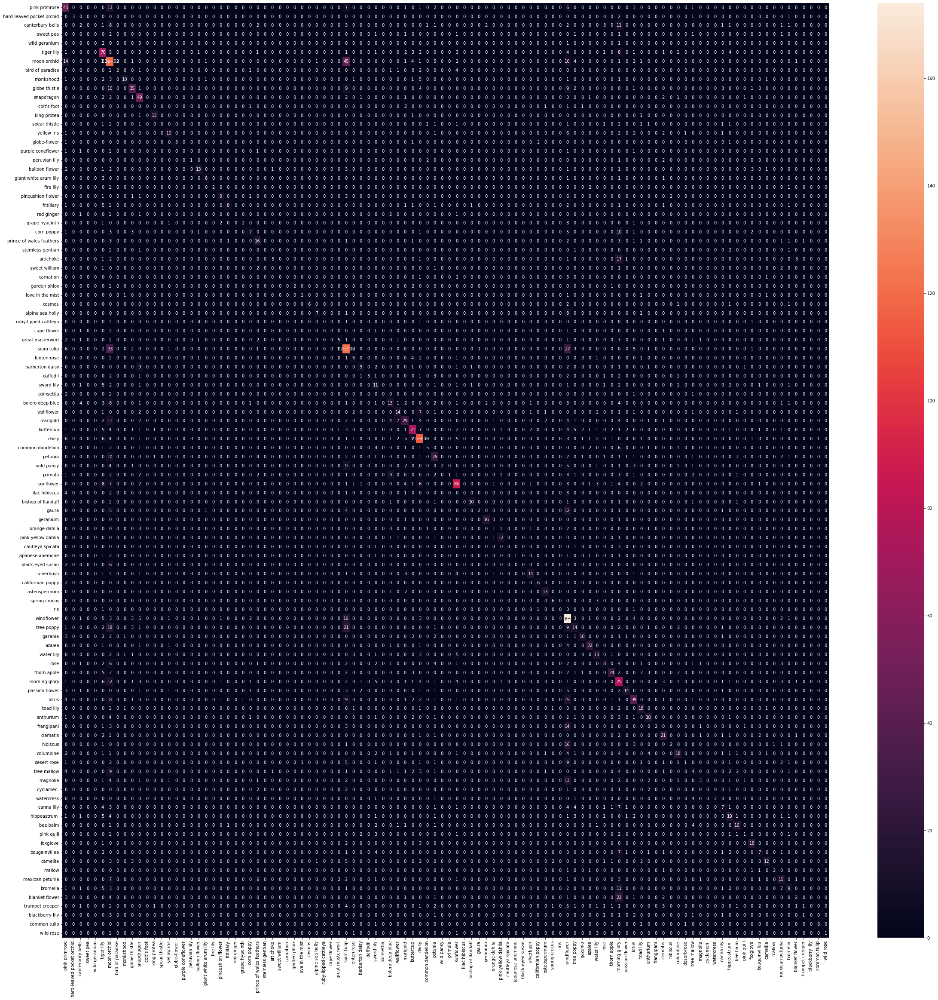

In [ ]:
index = CLASSES 
columns = CLASSES 
cm_df = pd.DataFrame(cm,columns,index)                      
plt.figure(figsize=(40,40))  
sns.heatmap(cm_df, annot=True)

In [ ]:
y_actual = pd.Series(y_true, name='Actual')
y_predicted = pd.Series(pred, name='Predicted')
h=(pd.crosstab(y_actual, y_predicted,rownames=['Actual'], colnames=['Predicted']))
h

Predicted,0,1,2,5,6,7,8,9,10,12,...,93,94,95,96,97,98,99,100,102,103
Actual,,,,,,,,,,,,,,,,,,,,,
0.0,45,0,0,0,13,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1.0,0,3,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
2.0,0,0,2,1,8,0,0,0,0,0,...,0,0,0,0,1,1,0,0,0,0
3.0,0,0,0,0,2,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
4.0,0,0,0,2,0,0,0,0,3,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99.0,3,0,0,0,4,0,0,0,0,0,...,0,0,0,0,0,0,2,0,0,0
100.0,0,0,1,0,1,0,0,0,0,1,...,0,2,0,0,0,0,1,1,0,0
101.0,0,0,0,0,3,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0


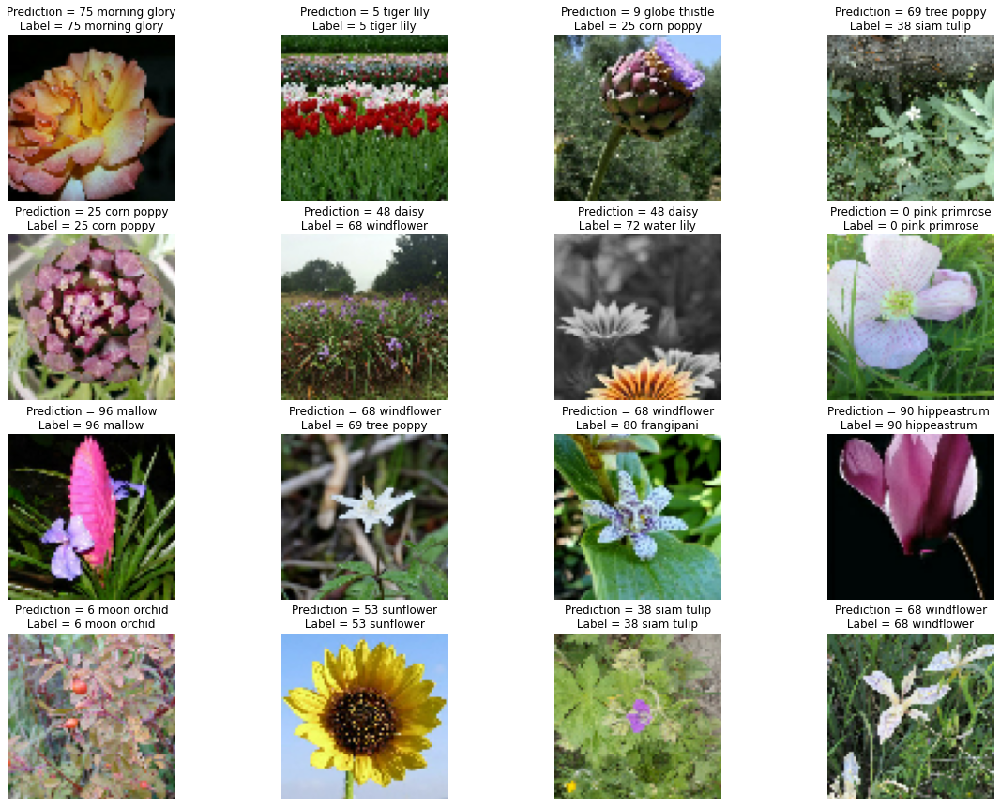

In [ ]:
plt.figure(figsize=(20,15))
for i in range(16):
  plt.subplot(4,4,i+1)
  plt.imshow(images[i])     
  plt.axis('off')
  prediction=pred[i]
  label=int(y_true[i])
  plt.title(f"Prediction = {prediction} {CLASSES[prediction]}\n Label = {label} {CLASSES[label]} ")

In [ ]:
true_labels,true_prediction,true_imgs,false_labels,false_prediction,false_imgs=split_TF_imgs(y_true,pred,images)

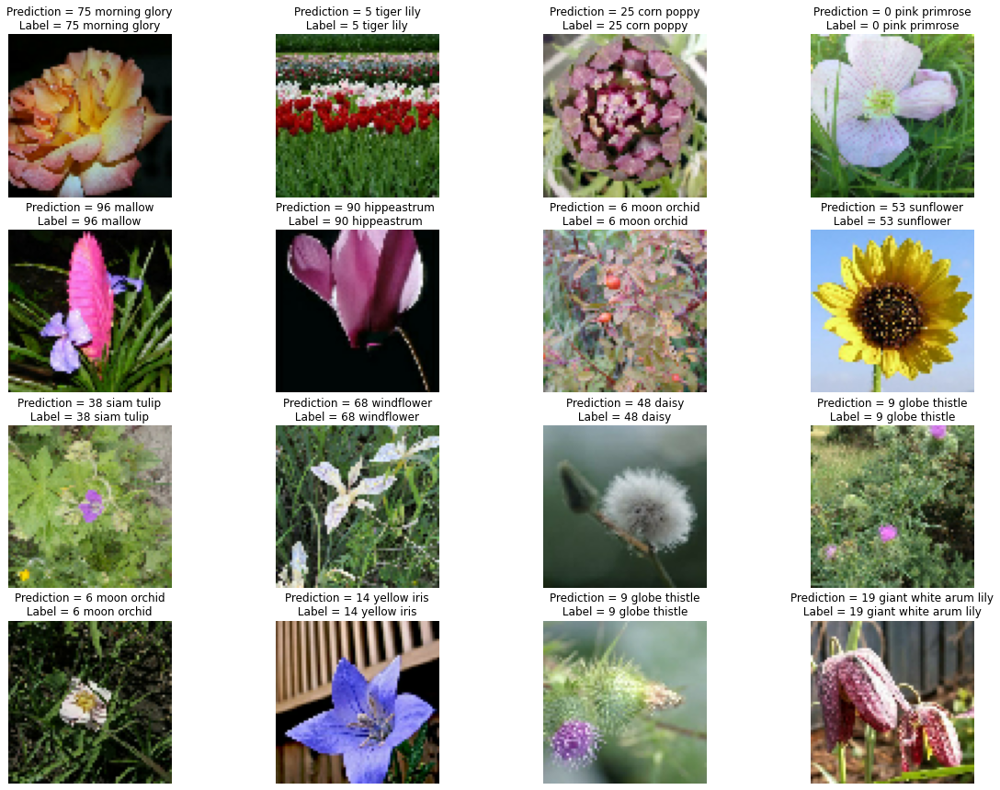

In [ ]:
plt.figure(figsize=(20,15))
for i in range(16):
  plt.subplot(4,4,i+1)
  plt.imshow(true_imgs[i])     
  plt.axis('off')
  prediction=true_prediction[i]
  label=int(true_labels[i])
  plt.title(f"Prediction = {prediction} {CLASSES[prediction]}\n Label = {label} {CLASSES[label]} ")

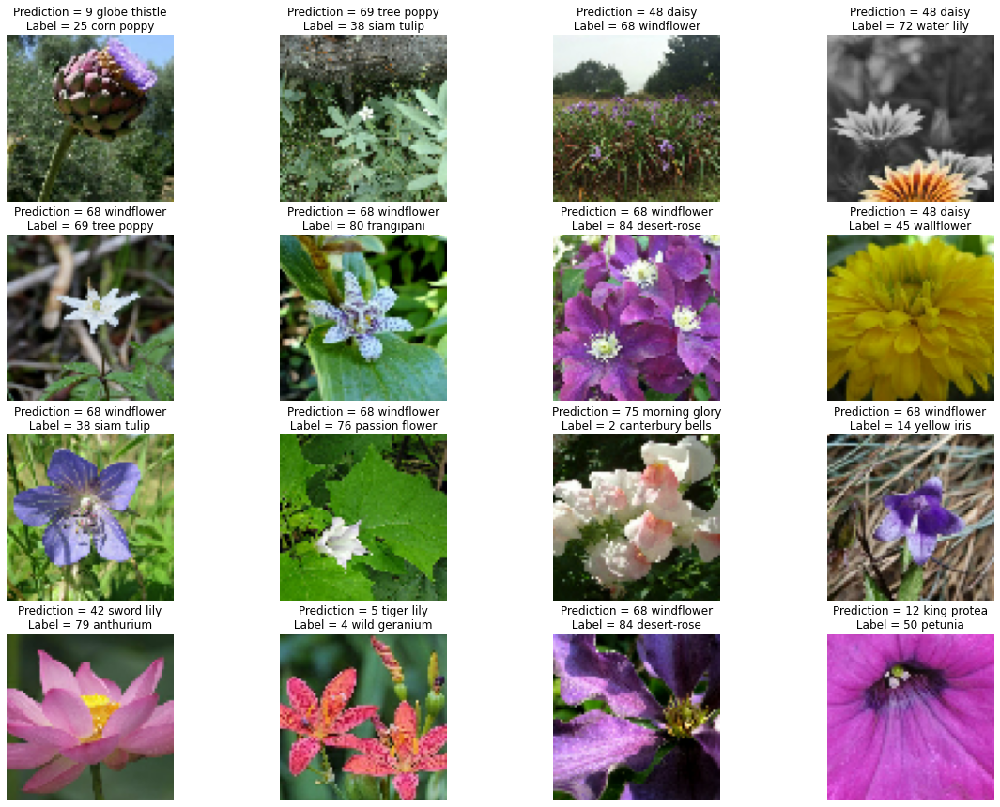

In [ ]:
plt.figure(figsize=(20,15))
for i in range(16):
  plt.subplot(4,4,i+1)
  plt.imshow(false_imgs[i])     
  plt.axis('off')
  prediction=false_prediction[i]
  label=int(false_labels[i])
  plt.title(f"Prediction = {prediction} {CLASSES[prediction]}\n Label = {label} {CLASSES[label]} ")

# First Ensemble Model

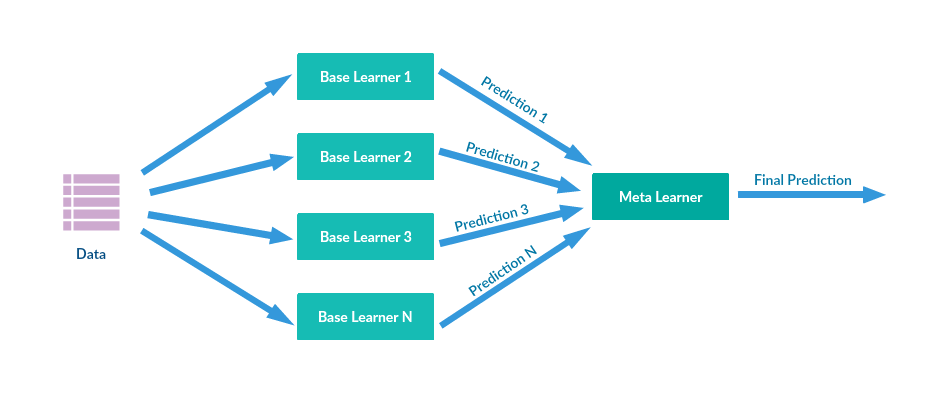

In [ ]:
# DataGenerator for Ensemble model
s=64
image_size = (s,s)
batch = 32
train_datagen = ImageDataGenerator(rescale = 1/255,
                                   validation_split=0.1,
                                   zoom_range = 0.1,       # Randomly zoom image 
                                   width_shift_range=0.1,  # randomly shift images horizontally (fraction of total width)
                                   height_shift_range=0.1 ,# randomly shift images vertically (fraction of total height)
                                   horizontal_flip=False,  # randomly flip images
                                   vertical_flip=False     # randomly flip images
                                   )
test_datagen = ImageDataGenerator(rescale = 1/255)



train_generator_Ensemble = train_datagen.flow_from_directory(trainpath,
                                                  target_size = image_size , 
                                                  batch_size = batch ,
                                                  subset = 'training',
                                                  shuffle=True,
                                                  class_mode = "categorical",
                                                   seed=42
                                                  )  

test_generator_Ensemble = test_datagen.flow_from_directory(testpath,
                                                  target_size = image_size , 
                                                  batch_size = batch ,
                                                  class_mode = 'categorical' ,
                                                   seed=42                                 
                                                  )
validation_generator_Ensemble = train_datagen.flow_from_directory(trainpath,
                                                  target_size = image_size , 
                                                  batch_size = batch ,
                                                  subset = 'validation',
                                                  shuffle=True,
                                                  class_mode = "categorical"
                                                   seed=42
                                                  )

In [ ]:
nets = 10
model = [0] *nets
for j in range(nets):
    model[j] = Sequential()
    model[j].add(Conv2D(64, kernel_size = 3, activation='relu', input_shape = (s, s, 3)))
    model[j].add(BatchNormalization())
    model[j].add(Conv2D(64, kernel_size = 3, activation='relu'))
    model[j].add(BatchNormalization())
    model[j].add(Conv2D(64, kernel_size = 5, strides=2, padding='same', activation='relu'))
    model[j].add(BatchNormalization())
    model[j].add(Dropout(0.103))

    #Second Layer of CNN
    model[j].add(Conv2D(128, kernel_size = 3, activation='relu'))
    model[j].add(BatchNormalization())
    model[j].add(Conv2D(128, kernel_size = 3, activation='relu'))
    model[j].add(BatchNormalization())
    model[j].add(Conv2D(6128, kernel_size = 5, strides=2, padding='same', activation='relu'))
    model[j].add(BatchNormalization())
    model[j].add(Dropout(0.103))

    #Third layer of CNN
    model[j].add(Conv2D(256, kernel_size = 4, activation='relu'))
    model[j].add(BatchNormalization())
    model[j].add(Flatten())
    model[j].add(Dropout(0.103))

    #Output layer
    model[j].add(Dense(104, activation='softmax'))

    # Compile each model
    model[j].compile(optimizer='adam', loss="categorical_crossentropy", metrics=["accuracy"])

In [ ]:
for j in range(nets):
    print(f'Individual Net : {j+1}')
    model[j].fit(train_generator_Ensemble,steps_per_epoch=120,epochs=10,validation_data=validation_generator_Ensemble,validation_steps=1229)

In [ ]:
for j in range(nets):
    model[j].save('ensemble.h5')

In [ ]:
new_model = load_model(os.path.join('/content/drive/MyDrive','ensemble.h5'))

In [ ]:
new_model.summary()

second model for enesamble

# second ensemble Model

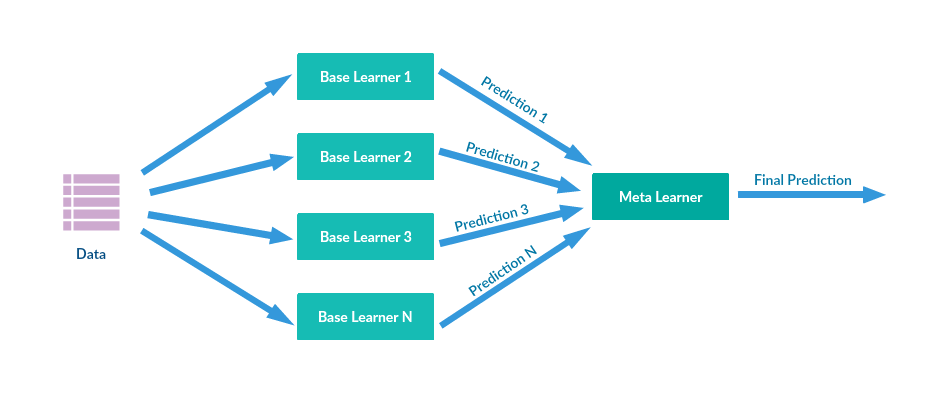

In [ ]:
model_1 = load_model(os.path.join('/content/drive/MyDrive/saved_models/simple','sm_5e_f.h5'))
model_1 = Model(inputs=model_1.inputs,
                outputs=model_1.outputs,
                name='name_of_model_1')
model_2 = load_model(os.path.join('/content/drive/MyDrive/saved_models/VGG','VGG_5e_f.h5'))
model_2 = Model(inputs=model_2.inputs,
                outputs=model_2.outputs,
                name='name_of_model_2')
models = [model_1, model_2]
model_input = Input(shape=(224,224, 3))
model_outputs = [model(model_input) for model in models]
ensemble_output = Average()(model_outputs)
ensemble_model = Model(inputs=model_input, outputs=ensemble_output, name='ensemble')
ensemble_model.compile(optimizer='adam',loss=tf.losses.SparseCategoricalCrossentropy(from_logits=False),metrics=['accuracy'])


In [ ]:
hist_ensemble=ensemble_model.fit(
train_generator,validation_data=validation_generator,epochs=5)

In [ ]:
acc = hist_ensemble.history['accuracy']
val_acc = hist_ensemble.history['val_accuracy']
loss =hist_ensemble.history['loss']
val_loss = hist_ensemble.history['val_loss']
epochs = range(len(acc))
plt.plot(epochs,acc,'r',label='Training accuracy')
plt.plot(epochs,val_acc,'b',label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()

plt.plot(epochs,loss,'r',label='Training Loss')
plt.plot(epochs,val_loss,'b',label='Validation Loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

In [ ]:
train_label = np.concatenate([y for x,y in train_generator],axis=0)
print(train_label.shape)
test_label = np.concatenate([y for x,y in test_generator],axis=0)
print(test_label.shape)

#comfusion matrix and classificxation repport
Y_pred =ensemble_model.predict_generator(validation_generator,1600)
y_pred = np.argmax(Y_pred,axis=1)
print("Confusion Matrix")
cm=confusion_matrix(test_label,y_pred)
print(cm)
print("Classification Report")
print(classification_report(test_label,y_pred,target_names=CLASSES))

In [ ]:
sns.set(font_scale=1.0)
ax=sns.heatmap(cm,annot=True,annot_kws={"size":22})
sns.set(font_scale=2.0)
ax.set_title('Seaborn Confusion Matrix with labels\n\n')
ax.set.xlabel('\nAcual Values')
ax.set.ylabel('Predicted Values ')

**Second Ensemble Model**

#ResNet


In [ ]:
resnet_model = Sequential()

pretrained_model= tf.keras.applications.ResNet50(include_top=False,
                   input_shape=(180,180,3),#(180,180,3)
                   pooling='avg',classes=104,
                   weights='imagenet')
for layer in pretrained_model.layers:
        layer.trainable=False

resnet_model.add(pretrained_model)

In [ ]:
resnet_model.add(Flatten())
resnet_model.add(Dense(600, activation='relu'))
resnet_model.add(Dense(104, activation='softmax'))

In [ ]:
print('TL Model Details are : ')
print(resnet_model.summary())

In [ ]:
plot_model(resnet_model)

In [ ]:
base_learning_rate = 0.0001
resnet_model.compile(optimizer=Adam(learning_rate=base_learning_rate),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

In [ ]:
epochs = 15
hist4 = resnet_model.fit(train_generator, epochs=epochs,batch_size=32,validation_data = validation_generator)

Epoch 1/15
361/361 [==============================] - 131s 355ms/step - loss: 4.1893 - accuracy: 0.0659 - val_loss: 4.0973 - val_accuracy: 0.0708
Epoch 2/15
361/361 [==============================] - 126s 348ms/step - loss: 4.1431 - accuracy: 0.0751 - val_loss: 4.0721 - val_accuracy: 0.0985
Epoch 3/15
361/361 [==============================] - 126s 350ms/step - loss: 4.1218 - accuracy: 0.0829 - val_loss: 4.0540 - val_accuracy: 0.0903
Epoch 4/15
361/361 [==============================] - 125s 347ms/step - loss: 4.1016 - accuracy: 0.0843 - val_loss: 4.0443 - val_accuracy: 0.0887
Epoch 5/15
361/361 [==============================] - 126s 349ms/step - loss: 4.0840 - accuracy: 0.0886 - val_loss: 4.0297 - val_accuracy: 0.1017
Epoch 6/15
361/361 [==============================] - 125s 347ms/step - loss: 4.0676 - accuracy: 0.0865 - val_loss: 4.0155 - val_accuracy: 0.1001
Epoch 7/15
361/361 [==============================] - 126s 349ms/step - loss: 4.0538 - accuracy: 0.0903 - val_loss: 4.0084 -

In [ ]:
resnet_model.save(os.path.join('/content/drive/MyDrive/saved_models','Trans.h5'))

In [ ]:
resnet_model.save_weights(os.path.join('/content/drive/MyDrive/saved_models','resnet_w_15e.h5'))

In [ ]:
resnet_model = load_model(os.path.join('saved_models','1_train90_test40.h5'))

In [ ]:
resnet_model.load_weights(os.path.join('/content/drive/MyDrive/saved_models','resnet_w_15e.h5'))

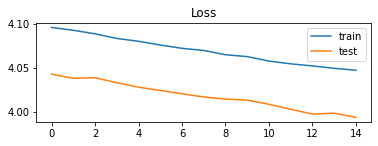

In [ ]:
# plot loss during training
plt.subplot(211)
plt.title('Loss')
plt.plot(hist4.history['loss'], label='train')
plt.plot(hist4.history['val_loss'], label='test')
plt.legend()

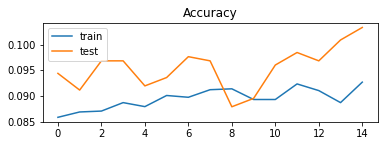

In [ ]:
# plot accuracy during training
plt.subplot(212)
plt.title('Accuracy')
plt.plot(hist4.history['accuracy'], label='train')
plt.plot(hist4.history['val_accuracy'], label='test')
plt.legend()
plt.show()

In [ ]:
resnet_model_Loss, resnet_model_Accuracy = resnet_model.evaluate(test_generator3)

print(f'Test Loss is {resnet_model_Loss}')
print(f'Test Accuracy is {resnet_model_Accuracy}')

116/116 [==============================] - 13s 113ms/step - loss: 4.0338 - accuracy: 0.0884
Test Loss is 4.03379487991333
Test Accuracy is 0.08836206793785095


In [ ]:
y_true,p,images=test(resnet_model,test_generator3)
pred=[np.argmax(elements) for elements in p]

In [ ]:
# Accuracy: Percentage of correct predictions
# Precision: Correct positive predictions relative to total positive predictions
# Recall: Correct positive predictions relative to total actual positives
fscore=f1_score(y_true, pred, average='macro')
accuracy=accuracy_score(y_true, pred)
precision=(precision_score(y_true, pred, average='macro'))
recall=recall_score(y_true, pred, average='macro')
print(f' Accuracy = {accuracy}\nPrecision = {precision}\n  Recall  = {recall}\n  fscore  = {fscore}')

 Accuracy = 0.44288793103448276
Precision = 0.4881750263646421
  Recall  = 0.314402744146657
  fscore  = 0.34283242134598607


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
cr=classification_report(y_true, pred ,target_names=CLASSES)
print(cr)

                           precision    recall  f1-score   support

            pink primrose       0.38      0.57      0.45        79
hard-leaved pocket orchid       1.00      0.43      0.60         7
         canterbury bells       0.12      0.05      0.07        40
                sweet pea       0.00      0.00      0.00         9
            wild geranium       0.00      0.00      0.00         7
               tiger lily       0.40      0.61      0.48       114
              moon orchid       0.30      0.55      0.39       216
         bird of paradise       1.00      0.15      0.27        13
                monkshood       0.71      0.37      0.49        27
            globe thistle       0.61      0.45      0.52        77
               snapdragon       0.49      0.74      0.59        66
              colt's foot       0.00      0.00      0.00         6
              king protea       0.81      0.81      0.81        16
            spear thistle       0.00      0.00      0.00     

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
cm=confusion_matrix(y_true=y_true, y_pred=pred)
print(cm)

[[45  0  0 ...  0  0  0]
 [ 0  3  0 ...  0  0  0]
 [ 0  0  2 ...  0  0  0]
 ...
 [ 0  0  0 ...  0  0  0]
 [ 0  0  0 ...  0  6  0]
 [ 0  0  0 ...  0  0  1]]


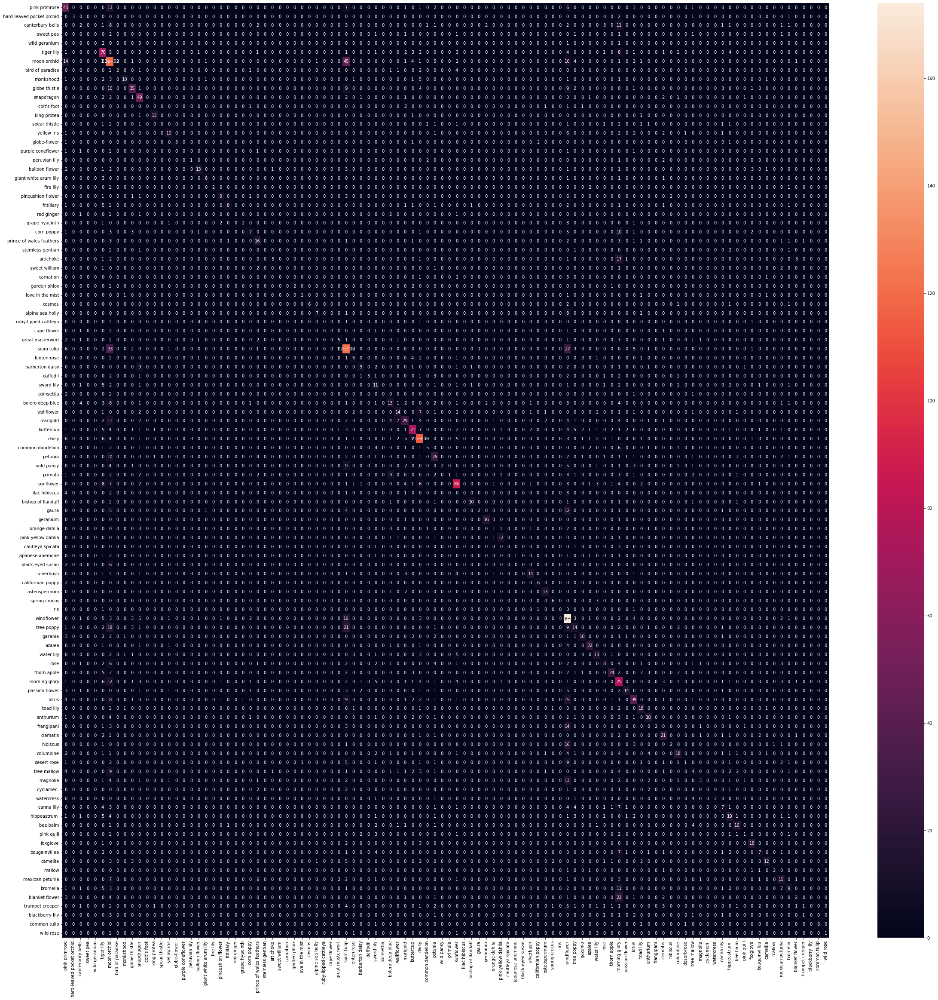

In [ ]:
index = CLASSES 
columns = CLASSES 
cm_df = pd.DataFrame(cm,columns,index)                      
plt.figure(figsize=(40,40))  
sns.heatmap(cm_df, annot=True)

In [ ]:
y_actual = pd.Series(y_true, name='Actual')
y_predicted = pd.Series(pred, name='Predicted')
h=(pd.crosstab(y_actual, y_predicted,rownames=['Actual'], colnames=['Predicted']))
h

Predicted,0,1,2,5,6,7,8,9,10,12,...,93,94,95,96,97,98,99,100,102,103
Actual,,,,,,,,,,,,,,,,,,,,,
0.0,45,0,0,0,13,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1.0,0,3,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
2.0,0,0,2,1,8,0,0,0,0,0,...,0,0,0,0,1,1,0,0,0,0
3.0,0,0,0,0,2,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
4.0,0,0,0,2,0,0,0,0,3,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99.0,3,0,0,0,4,0,0,0,0,0,...,0,0,0,0,0,0,2,0,0,0
100.0,0,0,1,0,1,0,0,0,0,1,...,0,2,0,0,0,0,1,1,0,0
101.0,0,0,0,0,3,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0


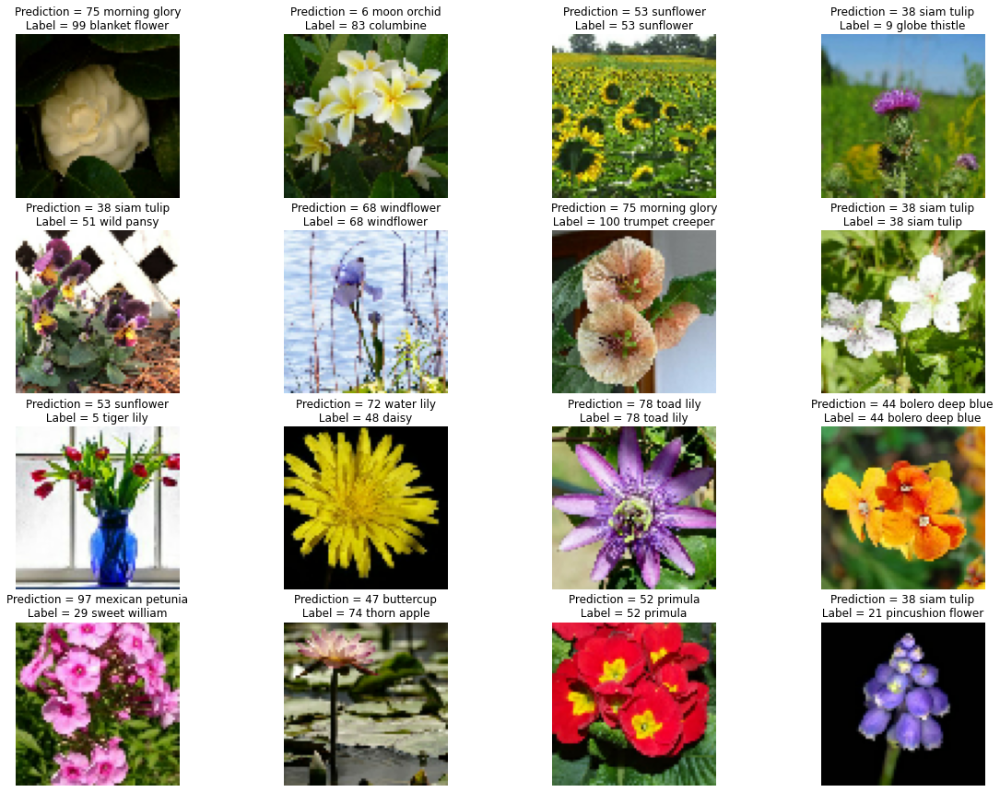

In [ ]:
plt.figure(figsize=(20,15))
for i in range(16):
  plt.subplot(4,4,i+1)
  plt.imshow(images[i])     
  plt.axis('off')
  prediction=pred[i]
  label=int(y_true[i])
  plt.title(f"Prediction = {prediction} {CLASSES[prediction]}\n Label = {label} {CLASSES[label]} ")

In [ ]:
true_labels,true_prediction,true_imgs,false_labels,false_prediction,false_imgs=split_TF_imgs(y_true,pred,images)

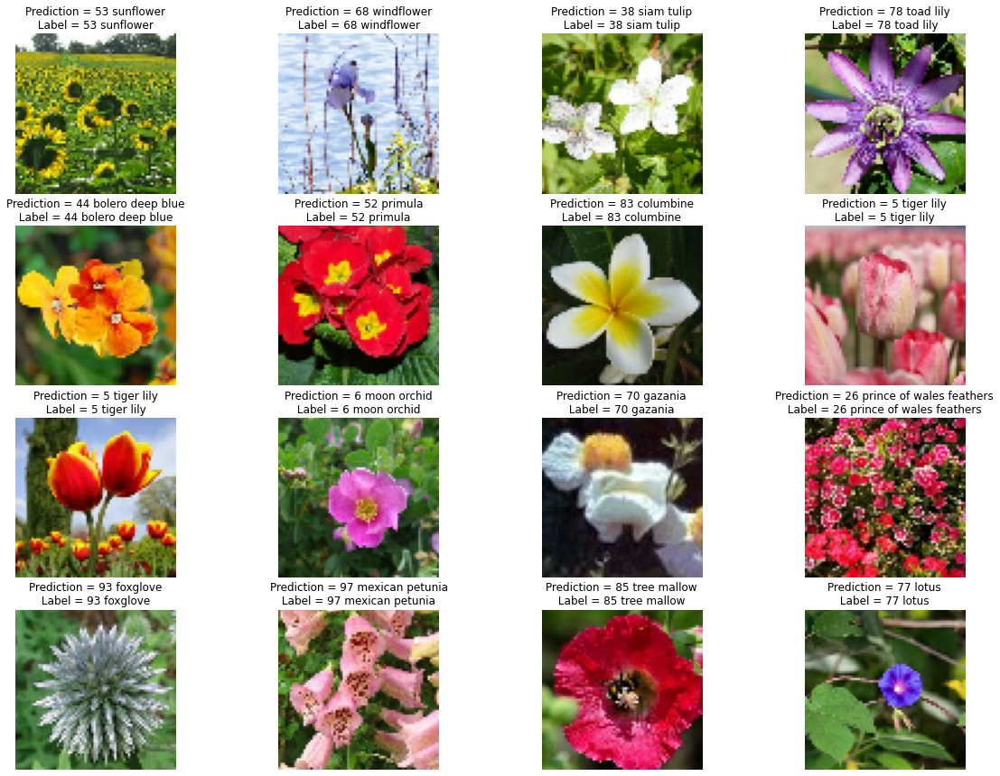

In [ ]:
plt.figure(figsize=(20,15))
for i in range(16):
  plt.subplot(4,4,i+1)
  plt.imshow(true_imgs[i])     
  plt.axis('off')
  prediction=true_prediction[i]
  label=int(true_labels[i])
  plt.title(f"Prediction = {prediction} {CLASSES[prediction]}\n Label = {label} {CLASSES[label]} ")

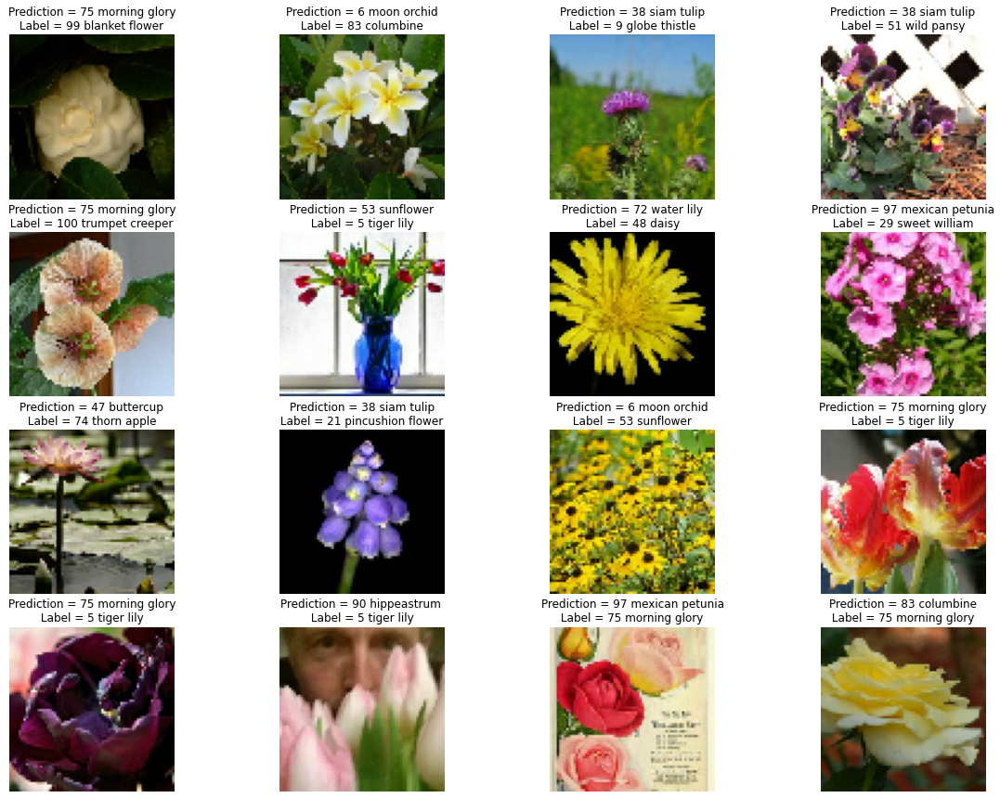

In [ ]:
plt.figure(figsize=(20,15))
for i in range(16):
  plt.subplot(4,4,i+1)
  plt.imshow(false_imgs[i])     
  plt.axis('off')
  prediction=false_prediction[i]
  label=int(false_labels[i])
  plt.title(f"Prediction = {prediction} {CLASSES[prediction]}\n Label = {label} {CLASSES[label]} ")